
### Jupyter Notebook
# **Anomalies analysis**
## **Sample CAAS data**

<br>
<br>
<br>

In [1]:
from flight import Flight

# In tp_flight.py but to make it visible here
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib

In [2]:
# Note this configuration for retina screens only
%config InlineBackend.figure_format = 'retina'


In [3]:
# More output formatting

matplotlib.style.use("dark_background")
pd.options.display.float_format = "{:,.2f}".format

In [4]:
# Only if you're editing the extensions

%load_ext autoreload
%autoreload 2

# Bad behaviour analysis for all Arrivals

### Transform all descents (just done once)

### Expand the flights

### Save in dataframe

### Load arrivals dataframe

In [5]:
# Note that when using the Flight class,
# Flight.DEFAULT_DATA_DIR_NAME is taken into account already

Flight.load_dataframe(file_name="2019_november_arrivals.pkl")
Flight.dataframe_magnitudes()

Loaded dataframe with 15102 flights
Dataframe contains 15102 flights with 166122 values
Dataframe contains 15210890 tracks with 349850470 values
Dataframe contains 199590 fixes with 598770 values
In total, dataframe contains 350615362 values


### Contained data

In [6]:
Flight.main_dataframe.columns

Index(['Timebase', 'Callsign', 'ADEP', 'ADES', 'Aircraft', 'NumFixes',
       'NumTracks', 'Continuous', 'Fixes', 'Tracks', 'Additional'],
      dtype='object')

In [7]:
Flight.main_dataframe.iloc[0].Fixes.columns

Index(['Latitude', 'Longitude', 'FixName'], dtype='object')

In [8]:
Flight.main_dataframe.iloc[0].Tracks.columns

Index(['Time', 'Latitude', 'Longitude', 'Altitude', 'Vx', 'Vy', 'ClosestFix',
       'theta', 'alpha_1', 'b_1', 'cos_b_1', 'alpha_2', 'b_2', 'cos_b_2',
       'c_1', 'c_2', 'd_1', 'd_2', 'l_1_l', 'l_1_t', 'l_2_l', 'l_2_t',
       'c_min'],
      dtype='object')

In [9]:
Flight.main_dataframe.iloc[0].Additional

{'c_max': 0.0796605131802425,
 'c_mean': 0.011709193905479424,
 'alt_max': 10972.8}

### Generating the flight objects

In [10]:
arrivals = Flight.create_flights()

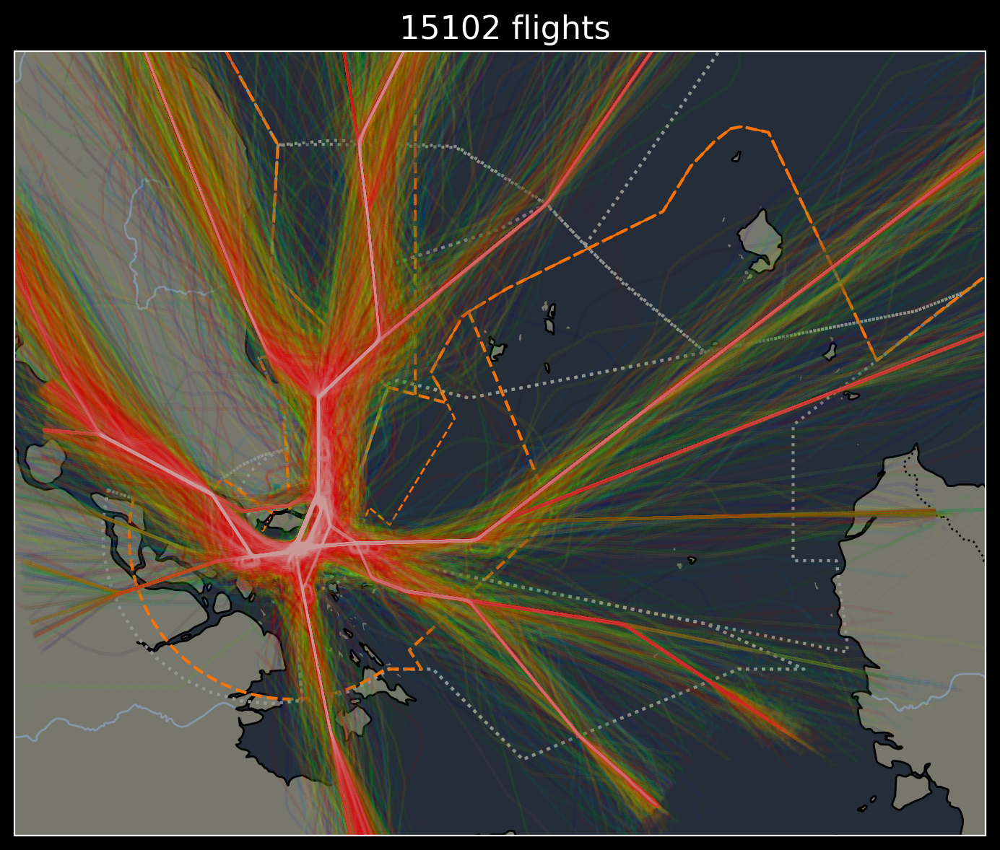

In [11]:
# render 1000km x 1000km
Flight.plot_very_long_list(
    flights=arrivals,
    wide=500,
    alpha=0.02,
    cmap="nipy_spectral",
    move_east=200,
    move_north=100,
    ratio=0.8,
)

## Looking at descent profile

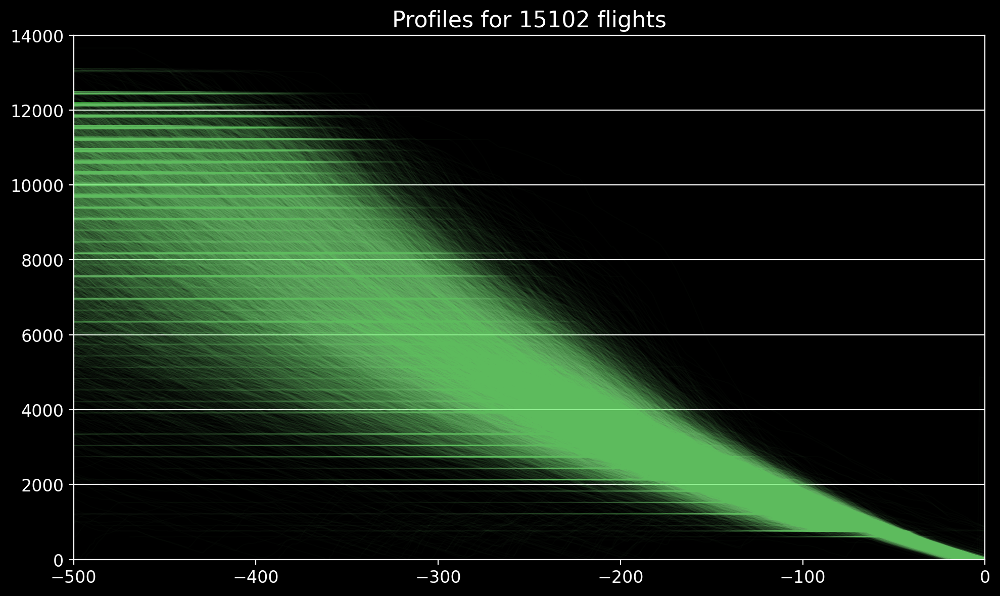

In [12]:
Flight.plot_elevation_profile(
    flights=arrivals, ylim=14000, endalign=True, alpha=0.02
)

# Note, every unit 4 sec => 45 min = 675 units

# Dispersion ~ 25 minutes

## Behaviour filtering

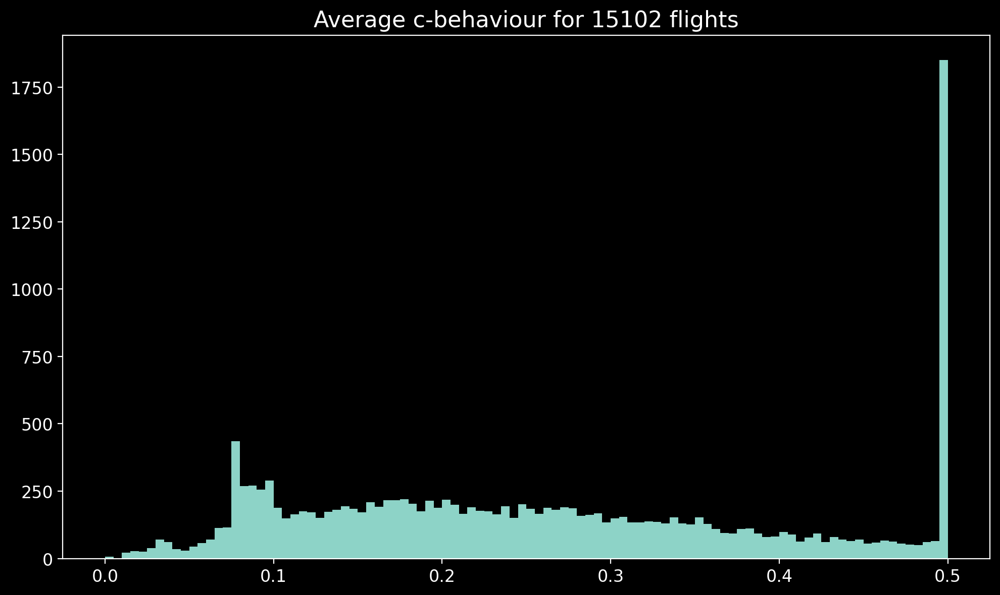

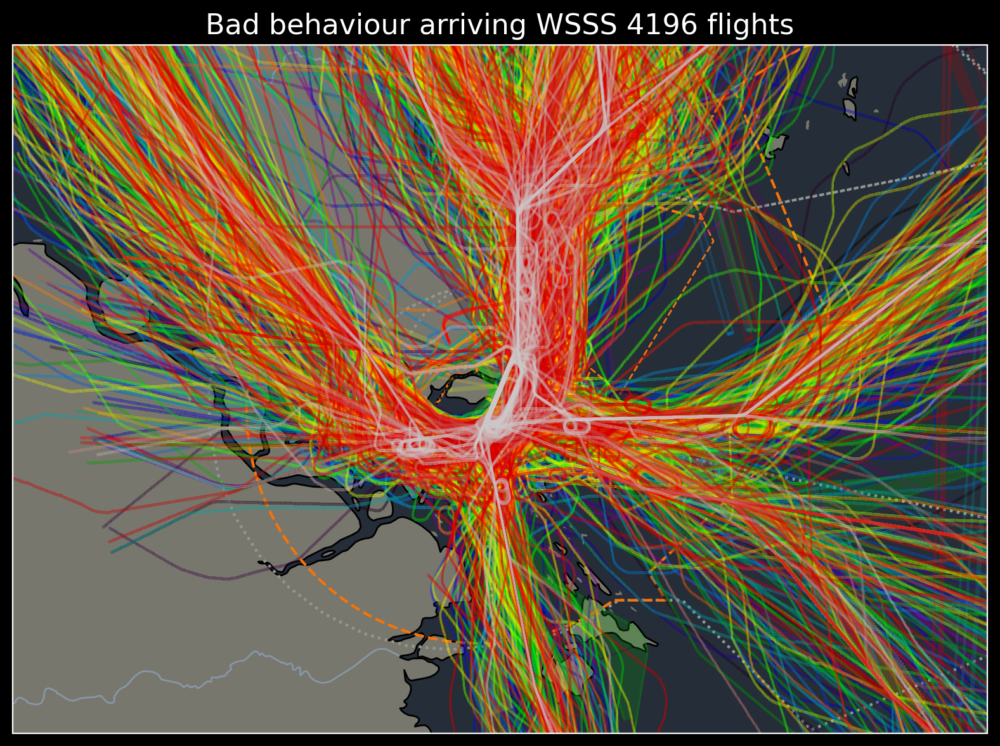

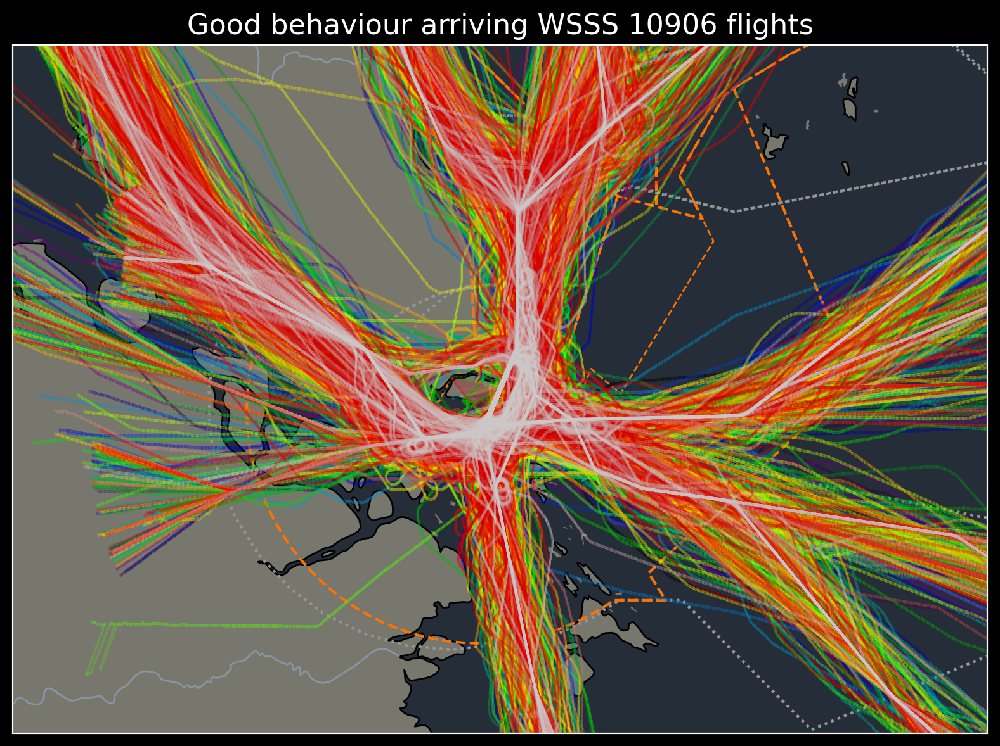

In [13]:
# Histogram and behaviour filtering

# Offender threshold
offender_threshold = 0.35  # To punish deviations
offender_mean_factor = 0.2  # To factor average deviation in

# Histogram

# Set a max value for better view
clip = 0.5

behaviour = [
    min(b_, clip)
    for b_ in [
        flight.additional["c_mean"] * offender_mean_factor
        + flight.additional["c_max"]
        for flight in arrivals
    ]
]
Flight.plot_histogram(
    data=behaviour, bins=100, title="Average c-behaviour for"
)

# Two lists
arrivals_bad = [
    flight
    for flight in arrivals
    if flight.additional["c_mean"] * offender_mean_factor
    + flight.additional["c_max"]
    > offender_threshold
]
arrivals_good = [
    flight
    for flight in arrivals
    if flight.additional["c_mean"] * offender_mean_factor
    + flight.additional["c_max"]
    <= offender_threshold
]

Flight.plot_very_long_list(
    flights=arrivals_bad,
    wide=350,
    ratio=0.7,
    alpha=0.2,
    cmap="nipy_spectral",
    title="Bad behaviour arriving WSSS",
)
Flight.plot_very_long_list(
    flights=arrivals_good,
    wide=350,
    ratio=0.7,
    alpha=0.2,
    cmap="nipy_spectral",
    title="Good behaviour arriving WSSS",
)

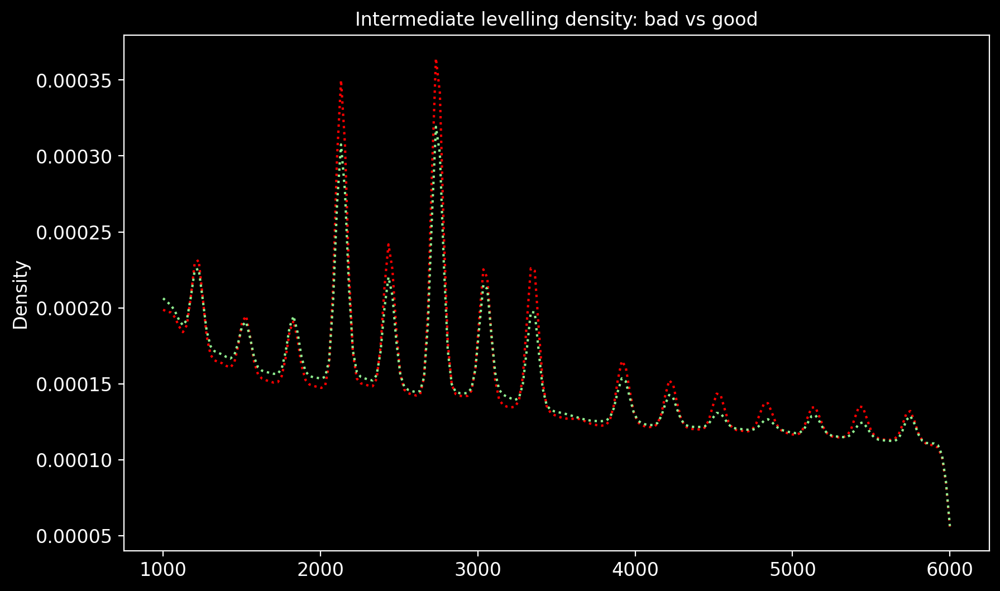

In [14]:
import itertools
import seaborn as sns

good_behaviour_altitudes = list(
    filter(
        lambda x: x < 6000,
        itertools.chain.from_iterable(
            [flight_.tracks.Altitude.to_list() for flight_ in arrivals_good],
        ),
    )
)

bad_behaviour_altitudes = list(
    filter(
        lambda x: x < 6000,
        itertools.chain.from_iterable(
            [flight_.tracks.Altitude.to_list() for flight_ in arrivals_bad],
        ),
    )
)

plt.title("Intermediate levelling density: bad vs good")
# sns.kdeplot(np.array(all_altitudes), bw=0.02, clip=(1000, 5000), fill=False)

sns.kdeplot(
    np.array(bad_behaviour_altitudes),
    bw=0.02,
    clip=(1000, 6000),
    fill=False,
    color="red",
    linestyle=":",
)
sns.kdeplot(
    np.array(good_behaviour_altitudes),
    bw=0.02,
    clip=(1000, 6000),
    fill=False,
    color="lightgreen",
    linestyle=":",
)
plt.show()

### Grabbing the dataframe

In [15]:
df = Flight.get_main_dataframe()
len(df)

15102

### C-factor feature

In [16]:
df["c_factor"] = df.apply(
    lambda x: x.Additional["c_mean"] * offender_mean_factor
    + x.Additional["c_max"],
    axis=1,
)
df["c"] = df["c_factor"] > offender_threshold

### Alt-max feature

In [17]:
df["alt_max"] = df.apply(
    lambda x: x.Additional["alt_max"],
    axis=1,
)

## Arrival hour

More significant than grouping

In [18]:
import datetime

df["Arrival"] = (
    df.apply(lambda x: x["Tracks"].iloc[-1]["Time"], axis=1) * 4
    + df["Timebase"]
    # + 8 * 60 * 60 no need, already SGT
)

df["Arrival_h"] = df.Arrival.apply(
    lambda d: datetime.datetime.fromtimestamp(int(d)).strftime("%H")
).astype("category")

# pd.to_datetime(df["Arrival"], unit="s")

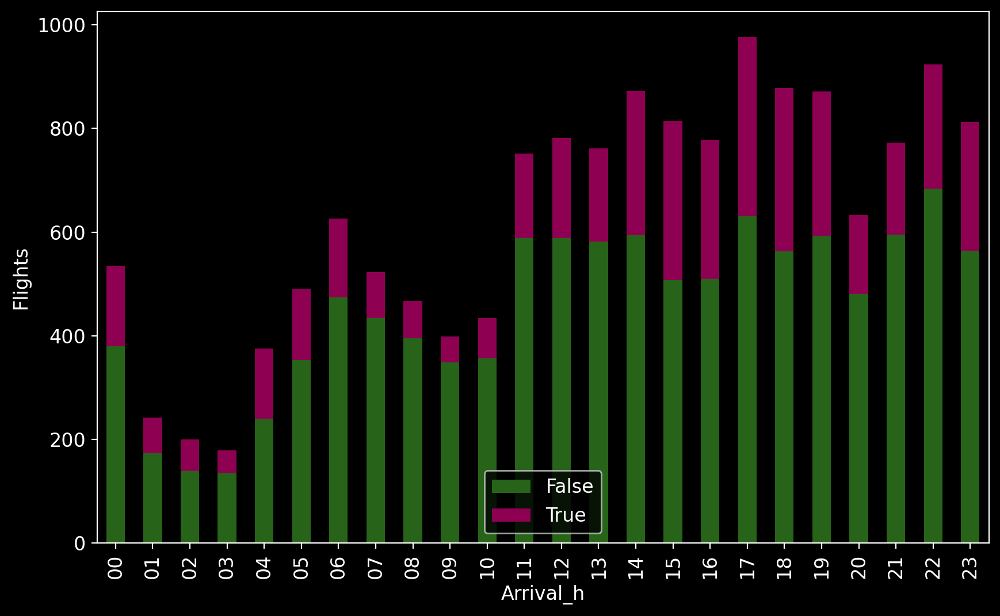

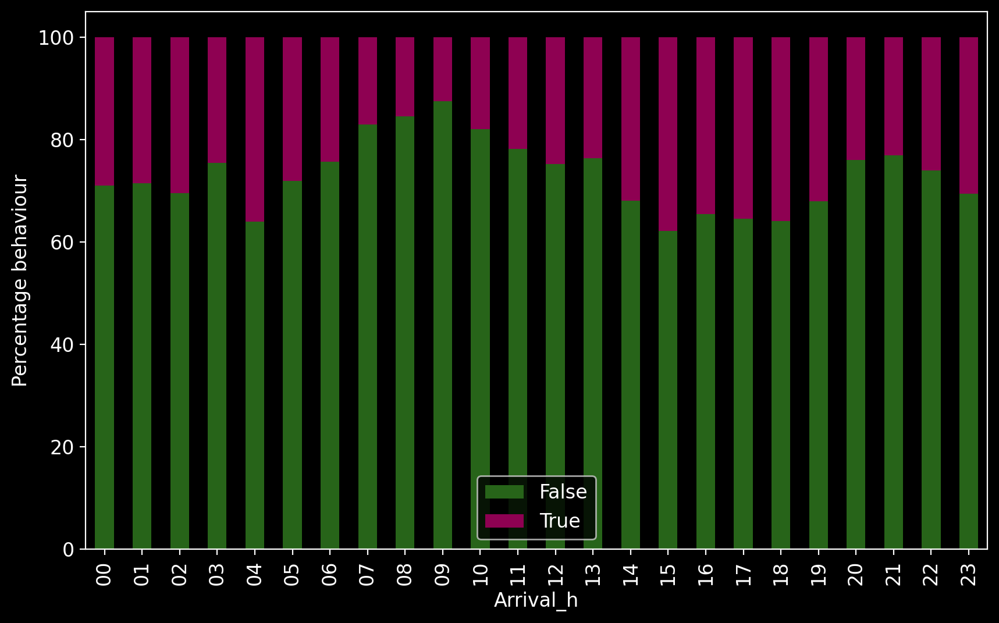

In [19]:
(pd.crosstab(df["Arrival_h"], df["c"])).plot(
    kind="bar", stacked=True, colormap="PiYG_r"
)
plt.ylabel("Flights")
plt.legend(loc="lower center")

(pd.crosstab(df["Arrival_h"], df["c"], normalize="index") * 100).plot(
    kind="bar", stacked=True, colormap="PiYG_r"
)
plt.ylabel("Percentage behaviour")
plt.legend(loc="lower center")
plt.show()

## Day of the week

More significant than weekday vs weekend

In [20]:
df["Arrival_wd"] = df.Arrival.apply(
    lambda d: datetime.datetime.fromtimestamp(int(d)).strftime("%w")
).astype("category")

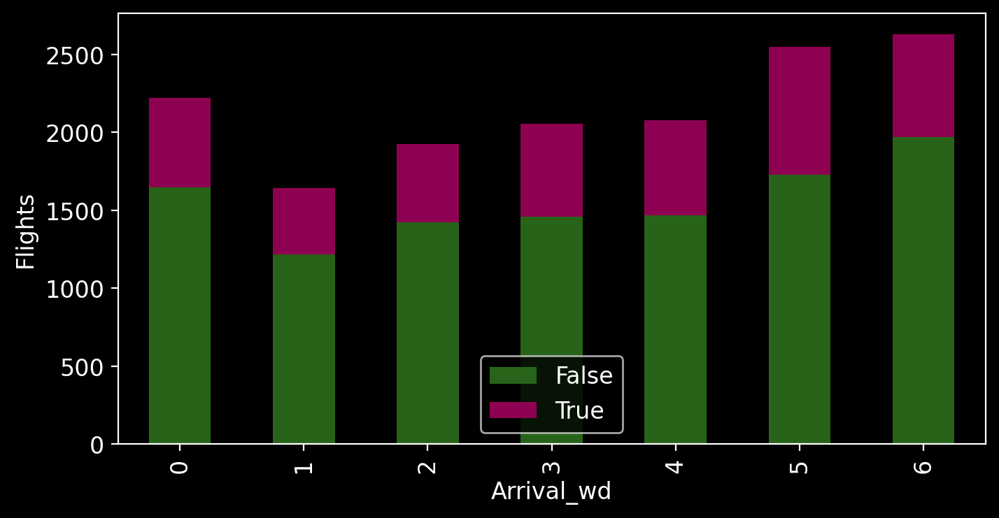

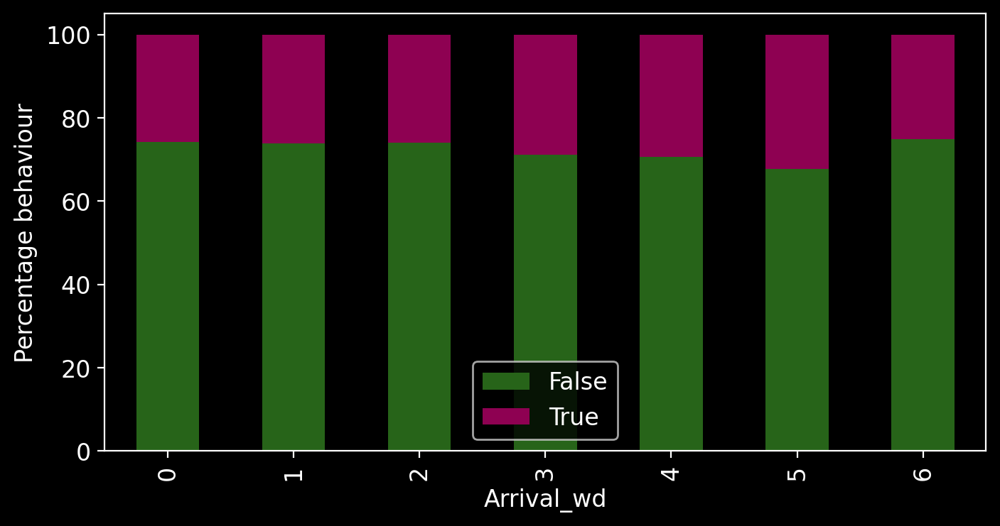

In [21]:
(pd.crosstab(df["Arrival_wd"], df["c"])).plot(
    kind="bar", figsize=(8, 4), stacked=True, colormap="PiYG_r"
)
plt.ylabel("Flights")
plt.legend(loc="lower center")

(pd.crosstab(df["Arrival_wd"], df["c"], normalize="index") * 100).plot(
    kind="bar", figsize=(8, 4), stacked=True, colormap="PiYG_r"
)
plt.ylabel("Percentage behaviour")
plt.legend(loc="lower center")

## WSSS arrival gates

### North

In [22]:
df["PASPU"] = df.apply(
    lambda x: "PASPU" in list(x["Fixes"].FixName)
    or "NYLON" in list(x["Fixes"].FixName)
    or "PIBAP" in list(x["Fixes"].FixName)
    or "PAS3" in list(x["Fixes"].FixName)
    or "PU90" in list(x["Fixes"].FixName)
    or "MABAL" in list(x["Fixes"].FixName)
    or "VPK" in list(x["Fixes"].FixName)
    or "KILOT" in list(x["Fixes"].FixName),
    axis=1,
)  # North

df["PASPU"].value_counts()

PASPU
False    9408
True     5694
Name: count, dtype: int64

### South

In [23]:
df["REMES"] = df.apply(
    lambda x: "REMES" in list(x["Fixes"].FixName)
    or "REPOV" in list(x["Fixes"].FixName)
    or "PARDI" in list(x["Fixes"].FixName),
    axis=1,
)  # South

df["REMES"].value_counts()

REMES
False    13526
True      1576
Name: count, dtype: int64

### East

In [24]:
df["LAVAX"] = df.apply(
    lambda x: "LAVAX" in list(x["Fixes"].FixName)
    or "IKAGO" in list(x["Fixes"].FixName)
    or "LAV1" in list(x["Fixes"].FixName)
    or "LAV2" in list(x["Fixes"].FixName)
    or "IKIMA" in list(x["Fixes"].FixName)
    or "TOMAN" in list(x["Fixes"].FixName)
    or "KARTO" in list(x["Fixes"].FixName)
    or "KEXAS" in list(x["Fixes"].FixName)
    or "IBULA" in list(x["Fixes"].FixName),
    axis=1,
)  # East

df["LAVAX"].value_counts()

LAVAX
False    11920
True      3182
Name: count, dtype: int64

### West

In [25]:
df["BOBAG"] = df.apply(
    lambda x: "BOBAG" in list(x["Fixes"].FixName)
    or "BOBOB" in list(x["Fixes"].FixName)
    or "BOG1" in list(x["Fixes"].FixName)
    or "BATAR" in list(x["Fixes"].FixName)
    or "TOPOR" in list(x["Fixes"].FixName)
    or "TAROS" in list(x["Fixes"].FixName)
    or "MIBEL" in list(x["Fixes"].FixName)
    or "MITOS" in list(x["Fixes"].FixName)
    or "OGAKO" in list(x["Fixes"].FixName)
    or "ARAMA" in list(x["Fixes"].FixName),
    axis=1,
)  # West

df["BOBAG"].value_counts()

BOBAG
False    9519
True     5583
Name: count, dtype: int64

### The rest

170


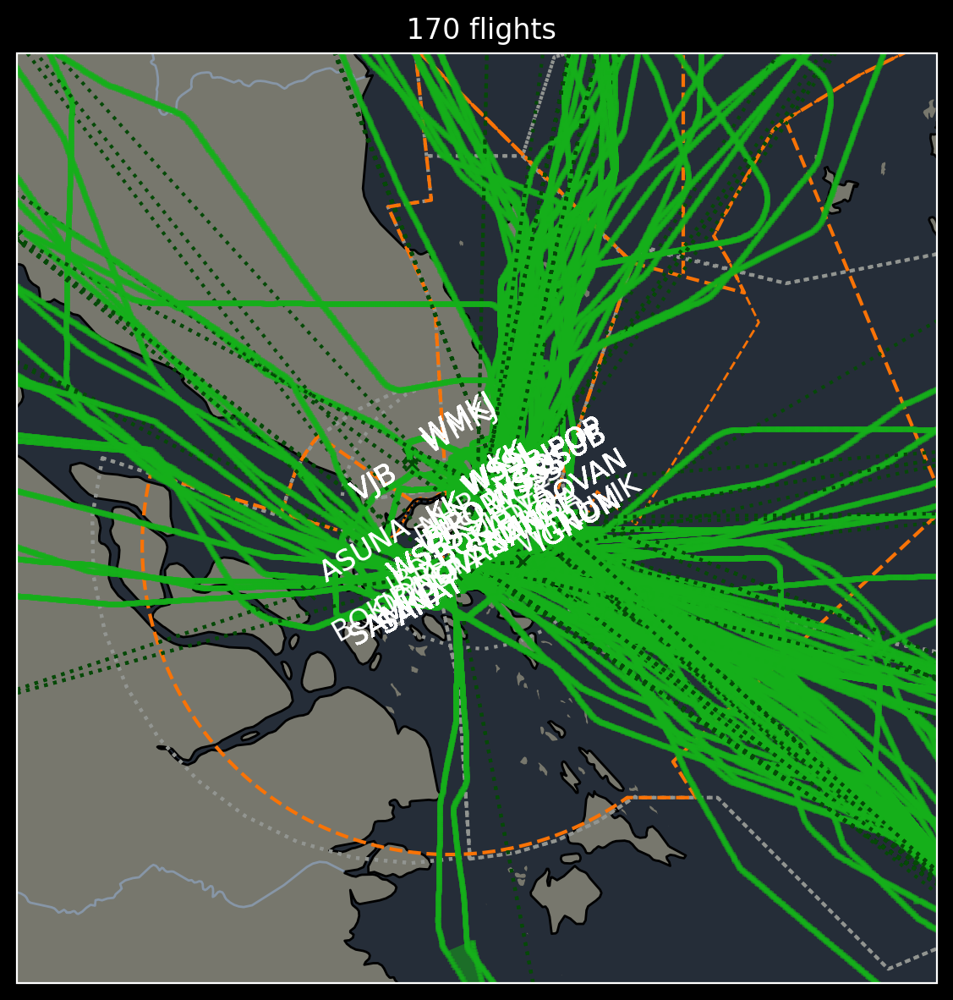

In [26]:
query_not_four_gates = (
    (df["BOBAG"] == False)
    & (df["LAVAX"] == False)
    & (df["REMES"] == False)
    & (df["PASPU"] == False)
)
not_four_gates = Flight.create_flights(
    df_filter=query_not_four_gates, from_dataframe=df
)
print(len(not_four_gates))

# Ingnoring SANAT (02) and BIPOP (20) for now

Flight.plot_list(not_four_gates, wide=250)

In [27]:
df1 = df.filter(["BOBAG", "LAVAX", "REMES", "PASPU"])
df1["ApproachGate"] = df1.idxmax(axis=1).where(df1.any(axis=1), "<OTHER>")

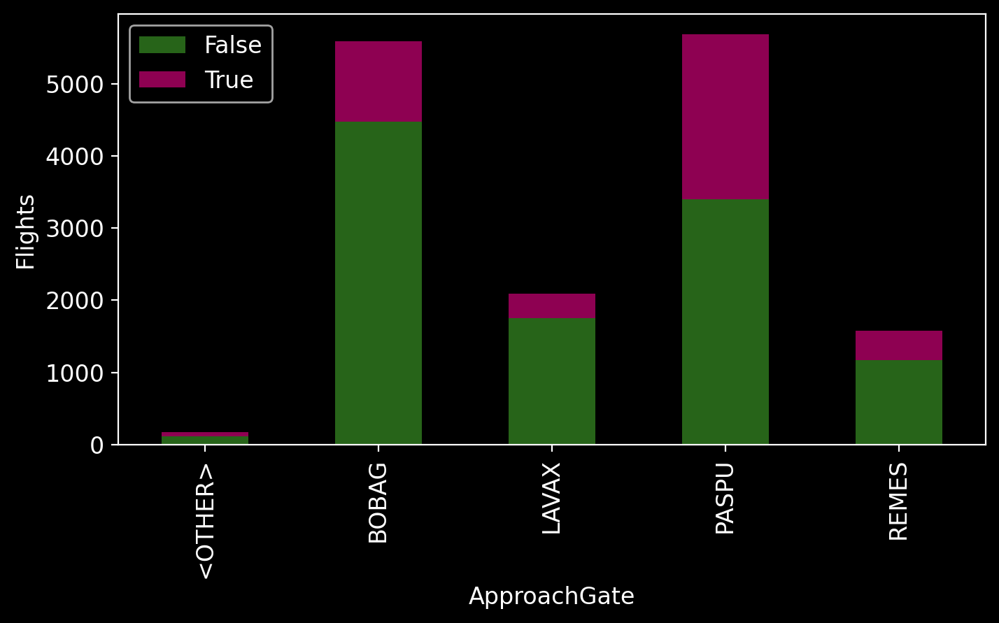

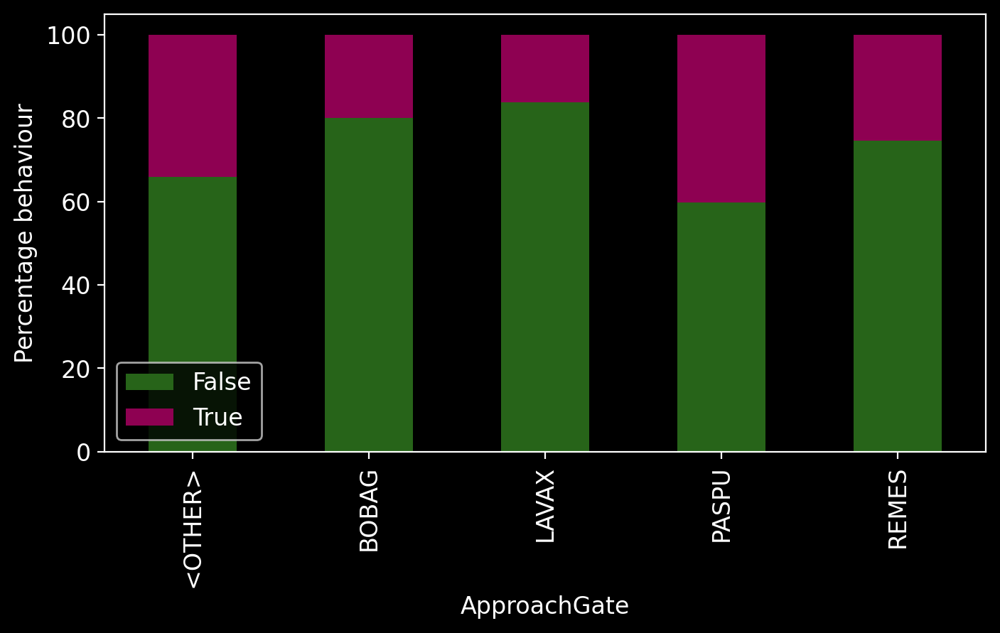

In [28]:
(pd.crosstab(df1["ApproachGate"], df["c"])).plot(
    kind="bar", figsize=(8, 4), stacked=True, colormap="PiYG_r"
)
plt.ylabel("Flights")
plt.legend(loc="upper left")

(pd.crosstab(df1["ApproachGate"], df["c"], normalize="index") * 100).plot(
    kind="bar", figsize=(8, 4), stacked=True, colormap="PiYG_r"
)
plt.ylabel("Percentage behaviour")
plt.legend(loc="lower left")
plt.show()

## Runway heading (BIBOP h20 vs SANAT h02)

In [29]:
df["h20"] = df.apply(
    lambda x: "BIPOP" in list(x["Fixes"].FixName)
    or "NYLON" in list(x["Fixes"].FixName)
    or "EGORA" in list(x["Fixes"].FixName)
    or "BIDUS" in list(x["Fixes"].FixName),
    axis=1,
)  # West

df["h20"].value_counts()

h20
True     7583
False    7519
Name: count, dtype: int64

In [30]:
df["h02"] = df.apply(
    lambda x: "SANAT" in list(x["Fixes"].FixName)
    or "SAMKO" in list(x["Fixes"].FixName)
    or "SADET" in list(x["Fixes"].FixName)
    or "C02A1" in list(x["Fixes"].FixName),
    axis=1,
)  # West

df["h02"].value_counts()

h02
True     11741
False     3361
Name: count, dtype: int64

140


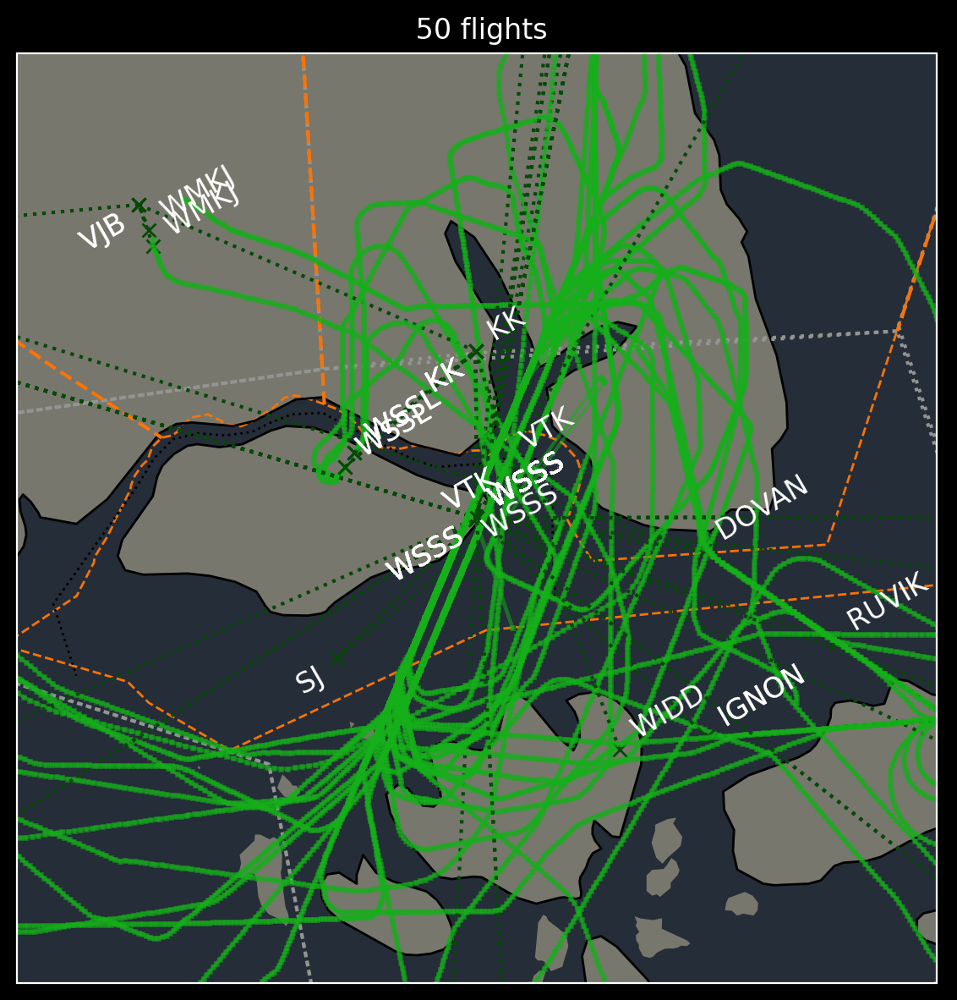

In [31]:
query_not_two_headings = (df["h02"] == False) & (df["h20"] == False)
not_two_headings = Flight.create_flights(
    df_filter=query_not_two_headings, from_dataframe=df
)
print(len(not_two_headings))

# Ingnoring SANAT (02) and BIPOP (20) for now

Flight.plot_list(not_two_headings[:50], wide=50)

In [32]:
df1 = df.filter(["h02", "h20"])
df1["RunwayHeading"] = df1.idxmax(axis=1).where(df1.any(axis=1), "<OTHER>")

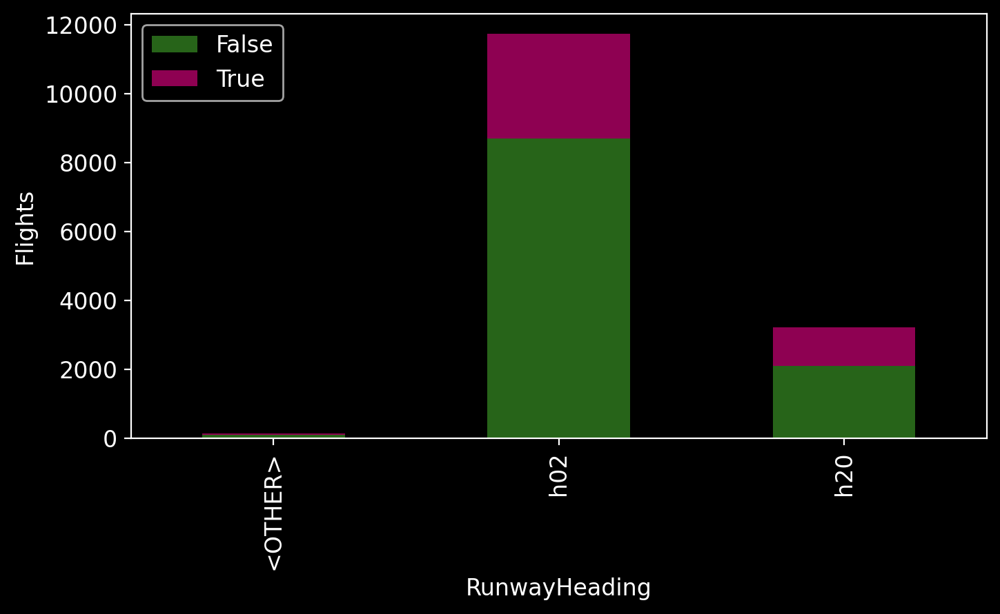

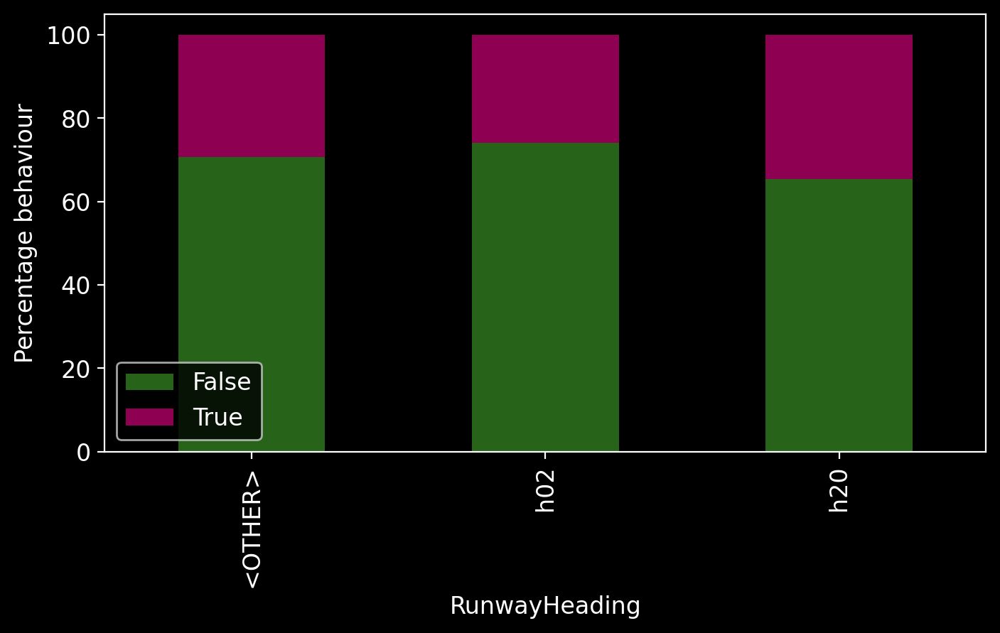

In [33]:
(pd.crosstab(df1["RunwayHeading"], df["c"])).plot(
    kind="bar", figsize=(8, 4), stacked=True, colormap="PiYG_r"
)
plt.ylabel("Flights")
plt.legend(loc="upper left")

(pd.crosstab(df1["RunwayHeading"], df["c"], normalize="index") * 100).plot(
    kind="bar", figsize=(8, 4), stacked=True, colormap="PiYG_r"
)
plt.ylabel("Percentage behaviour")
plt.legend(loc="lower left")
plt.show()

## KL departure 

In [34]:
df["WMKK"] = df.ADEP == "WMKK"
df["WMKK"].value_counts()

WMKK
False    13939
True      1163
Name: count, dtype: int64

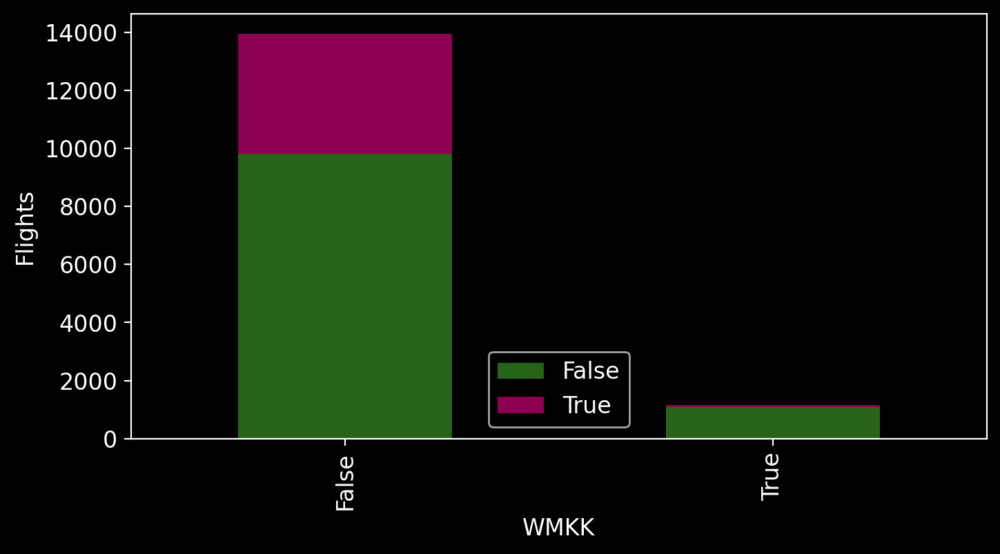

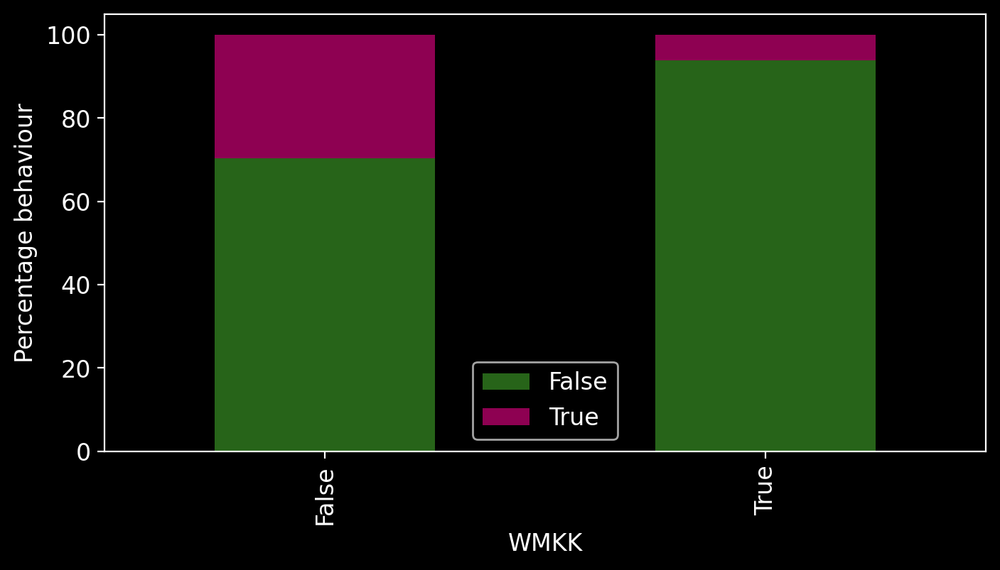

In [35]:
(pd.crosstab(df["WMKK"], df["c"])).plot(
    kind="bar", figsize=(8, 4), stacked=True, colormap="PiYG_r"
)
plt.ylabel("Flights")
plt.legend(loc="lower center")

(pd.crosstab(df["WMKK"], df["c"], normalize="index") * 100).plot(
    kind="bar", figsize=(8, 4), stacked=True, colormap="PiYG_r"
)
plt.ylabel("Percentage behaviour")
plt.legend(loc="lower center")
plt.show()

## Wake category

In [37]:
wake_turb_cat = pd.read_csv("aircraft_data/wake_turb_cat_df.csv").astype(
    "category"
)

wake_turb_cat.head()

,Aircraft,WakeTurbCat
0,A320,CAT-D
1,B738,CAT-D
2,A359,CAT-B
3,B77W,CAT-B
4,A388,CAT-A


In [38]:
df = df.merge(wake_turb_cat)

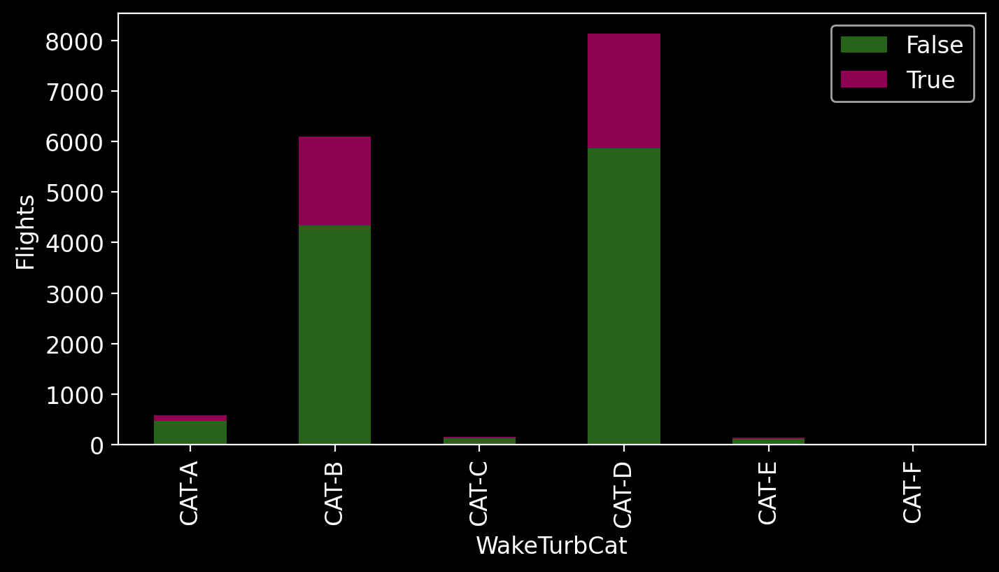

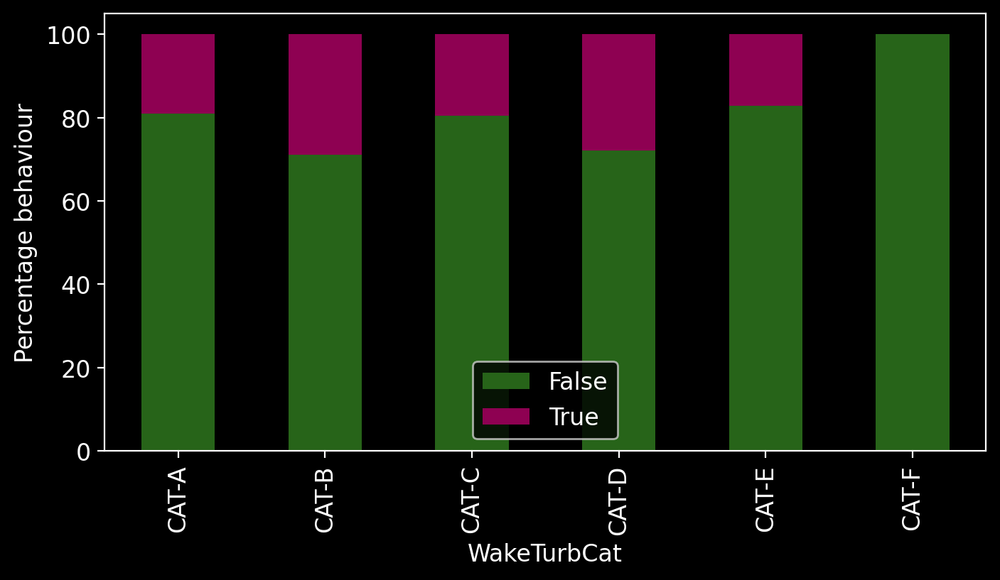

In [39]:
(pd.crosstab(df["WakeTurbCat"], df["c"])).plot(
    kind="bar", figsize=(8, 4), stacked=True, colormap="PiYG_r"
)
plt.ylabel("Flights")
plt.legend(loc="upper right")

(pd.crosstab(df["WakeTurbCat"], df["c"], normalize="index") * 100).plot(
    kind="bar", figsize=(8, 4), stacked=True, colormap="PiYG_r"
)
plt.ylabel("Percentage behaviour")
plt.legend(loc="lower center")
plt.show()

## Altitude

In [40]:
# Remove some noise

df = df[df.alt_max < 15000]

(0.0, 2.0)

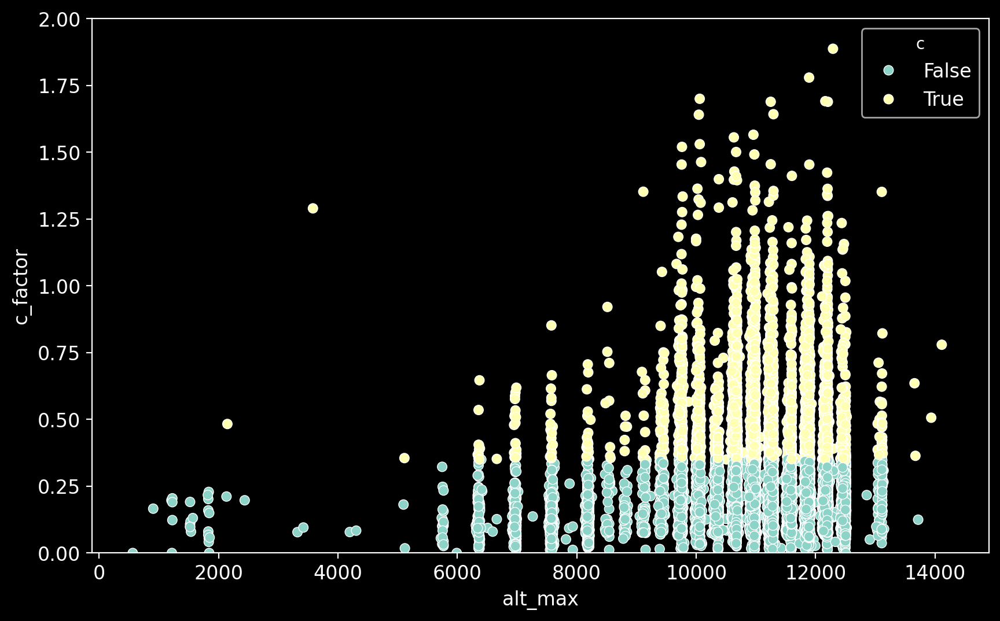

In [41]:
sns.scatterplot(data=df, x="alt_max", y="c_factor", hue="c")
plt.ylim(0, 2)

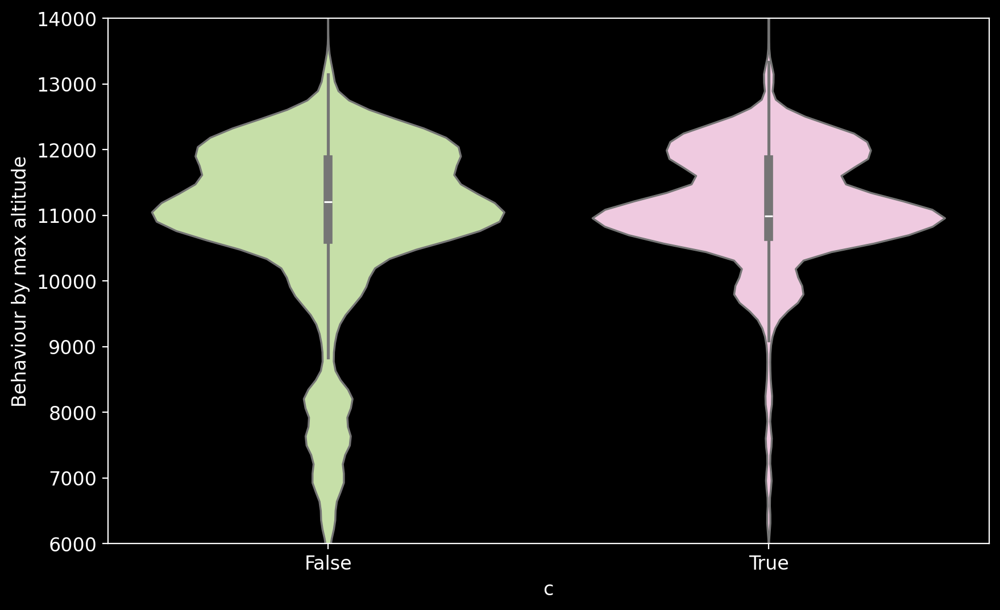

In [42]:
sns.violinplot(x=df["c"], y=df["alt_max"], palette="PiYG_r")
plt.ylabel("Behaviour by max altitude")
plt.ylim(6000, 14000)
plt.show()

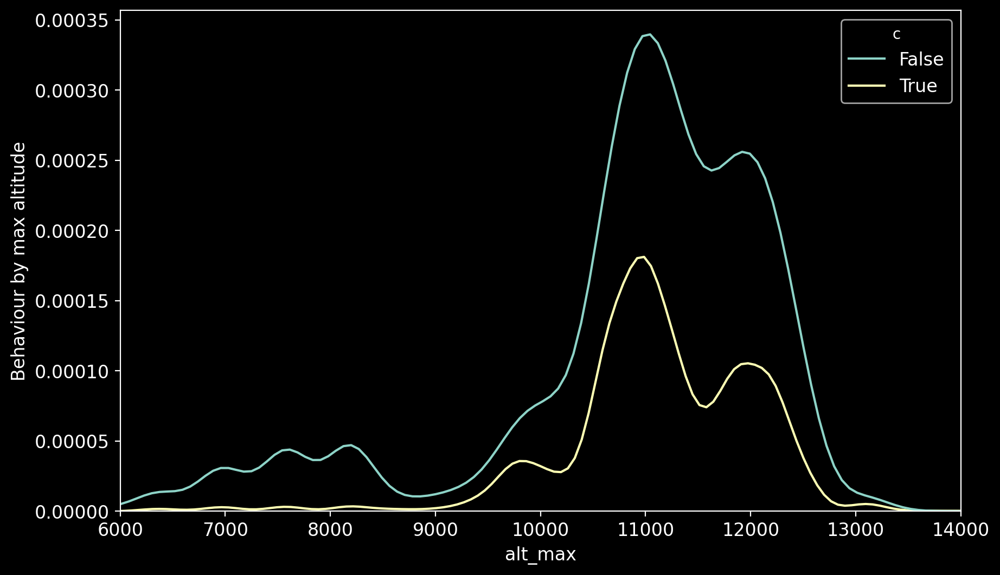

In [43]:
sns.kdeplot(data=df, x=df.alt_max, hue=df.c)
plt.xlim(6000, 14000)
plt.ylabel("Behaviour by max altitude")
plt.show()

### Check for spurious correlation

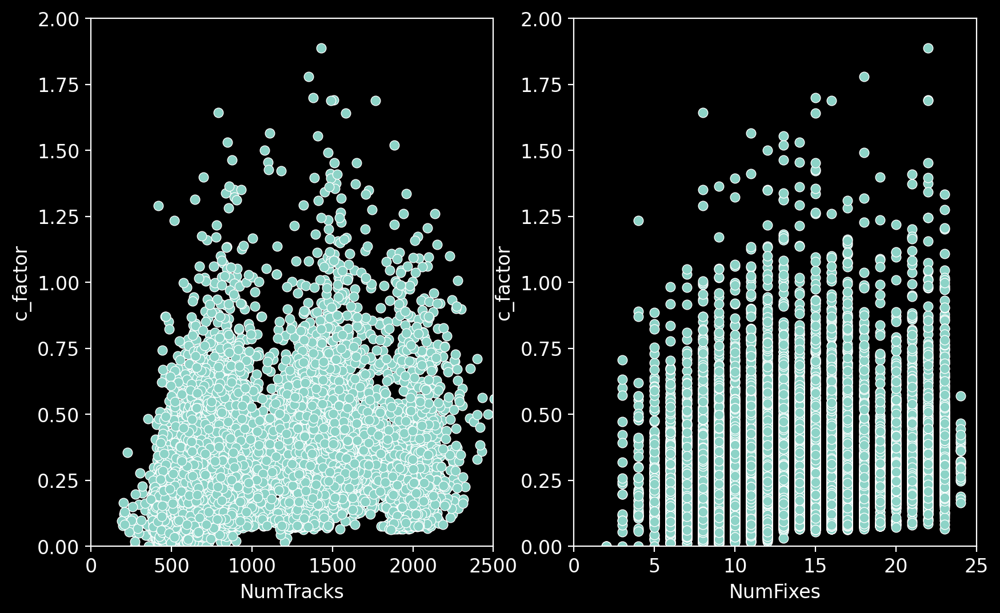

In [44]:
fig = plt.figure()

ax = fig.add_subplot(1, 2, 1)
sns.scatterplot(data=df, x="NumTracks", y="c_factor")
plt.xlim(0, 2500)
plt.ylim(0, 2)

ax = fig.add_subplot(1, 2, 2)
sns.scatterplot(data=df, x="NumFixes", y="c_factor")
plt.xlim(0, 25)
plt.ylim(0, 2)

plt.show()

## Clean up

In [45]:
dfclean = df
df.columns

Index(['Timebase', 'Callsign', 'ADEP', 'ADES', 'Aircraft', 'NumFixes',
       'NumTracks', 'Continuous', 'Fixes', 'Tracks', 'Additional', 'c_factor',
       'c', 'alt_max', 'Arrival', 'Arrival_h', 'Arrival_wd', 'PASPU', 'REMES',
       'LAVAX', 'BOBAG', 'h20', 'h02', 'WMKK', 'WakeTurbCat'],
      dtype='object')

In [46]:
# Drop the non-interesting columns
dfclean.drop(
    columns=[
        "Timebase",
        "Callsign",
        "ADES",
        "NumFixes",
        "NumTracks",
        "Continuous",
        "Fixes",
        "Tracks",
        "Additional",
        "Arrival",
        "ADEP",  # Should be refined
        "Aircraft",  # Used as wake turbulence category
    ],
    inplace=True,
    errors="ignore",
)

In [47]:
dfclean.describe(include="all").T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
c_factor,"15,092.00",NaN,NaN,NaN,0.29,0.28,0.00,0.14,0.24,0.37,11.43
c,15092,2,False,10901,NaN,NaN,NaN,NaN,NaN,NaN,NaN
alt_max,"15,092.00",NaN,NaN,NaN,"10,918.81","1,342.39",563.88,"10,666.14","10,995.66","11,849.10","14,219.08"
Arrival_h,15092,24,17,976,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Arrival_wd,15092,7,6,2630,NaN,NaN,NaN,NaN,NaN,NaN,NaN
PASPU,15092,2,False,9398,NaN,NaN,NaN,NaN,NaN,NaN,NaN
REMES,15092,2,False,13516,NaN,NaN,NaN,NaN,NaN,NaN,NaN
LAVAX,15092,2,False,11914,NaN,NaN,NaN,NaN,NaN,NaN,NaN
BOBAG,15092,2,False,9515,NaN,NaN,NaN,NaN,NaN,NaN,NaN
h20,15092,2,True,7582,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Correlation analysis

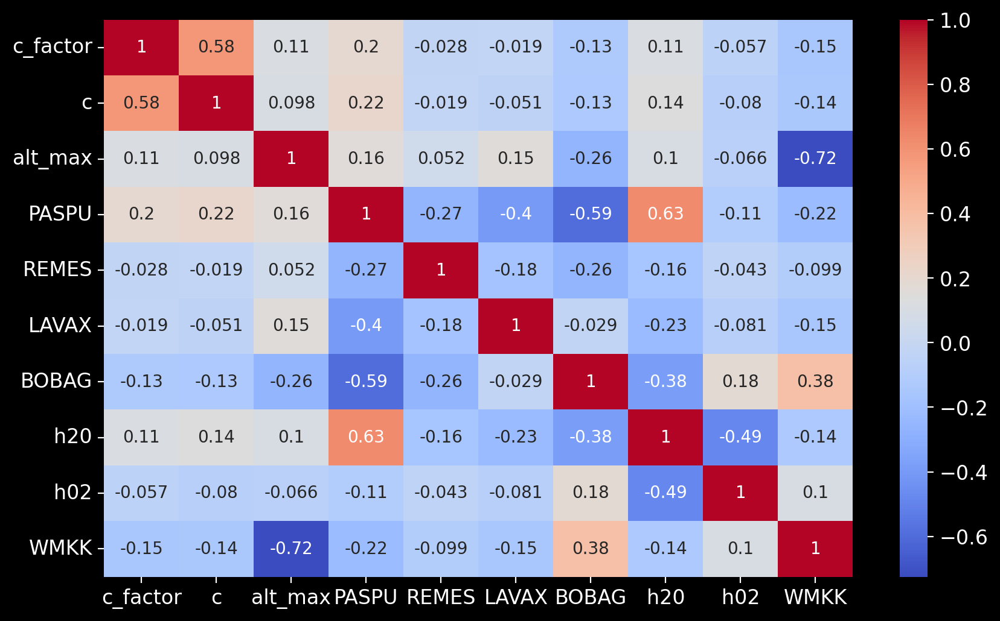

In [48]:
sns.heatmap(dfclean.corr(numeric_only=True), annot=True, cmap="coolwarm")
plt.show()

## Generating dummies

In [49]:
dfdummies = pd.get_dummies(dfclean)
dfdummies.columns

Index(['c_factor', 'c', 'alt_max', 'PASPU', 'REMES', 'LAVAX', 'BOBAG', 'h20',
       'h02', 'WMKK', 'Arrival_h_00', 'Arrival_h_01', 'Arrival_h_02',
       'Arrival_h_03', 'Arrival_h_04', 'Arrival_h_05', 'Arrival_h_06',
       'Arrival_h_07', 'Arrival_h_08', 'Arrival_h_09', 'Arrival_h_10',
       'Arrival_h_11', 'Arrival_h_12', 'Arrival_h_13', 'Arrival_h_14',
       'Arrival_h_15', 'Arrival_h_16', 'Arrival_h_17', 'Arrival_h_18',
       'Arrival_h_19', 'Arrival_h_20', 'Arrival_h_21', 'Arrival_h_22',
       'Arrival_h_23', 'Arrival_wd_0', 'Arrival_wd_1', 'Arrival_wd_2',
       'Arrival_wd_3', 'Arrival_wd_4', 'Arrival_wd_5', 'Arrival_wd_6',
       'WakeTurbCat_CAT-A', 'WakeTurbCat_CAT-B', 'WakeTurbCat_CAT-C',
       'WakeTurbCat_CAT-D', 'WakeTurbCat_CAT-E', 'WakeTurbCat_CAT-F'],
      dtype='object')

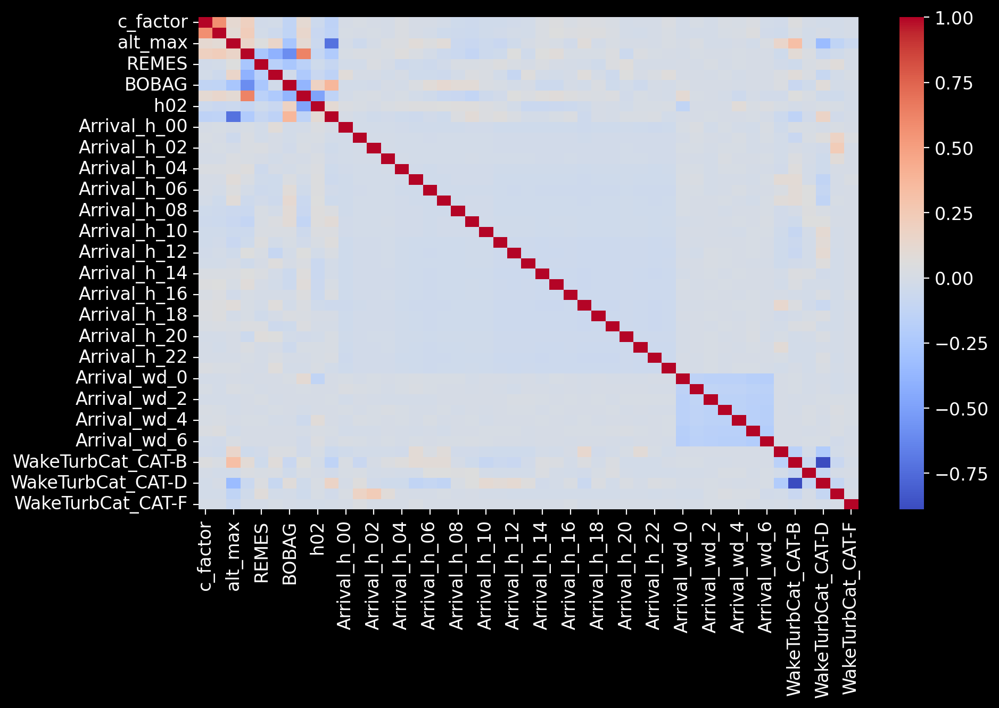

In [50]:
sns.heatmap(dfdummies.corr(numeric_only=True), annot=False, cmap="coolwarm")
plt.show()

## Split

In [51]:
from sklearn.model_selection import (
    train_test_split,
)  # Used to split the data into train and test sets.

In [52]:
features = dfdummies.drop(["c_factor", "c"], axis=1)

target_cont = dfdummies[["c_factor"]]
target_cat = dfdummies[["c"]]

In [53]:
(
    train_features,
    test_features,
    train_target_cont,
    test_target_cont,
    train_target_cat,
    test_target_cat,
) = train_test_split(
    features,
    target_cont,
    target_cat,
    train_size=0.8,
    test_size=0.2,
    shuffle=True,
)

# Regression

In [54]:
# Importing libraries for scaling the data
from sklearn.preprocessing import MinMaxScaler

# Importing libraries for building linear regression model
import statsmodels.api as sm

from statsmodels.stats.outliers_influence import variance_inflation_factor

In [55]:
# Creating an instance of the MinMaxScaler
scaler = MinMaxScaler()

# Applying fit_transform on the training features data
train_features_scaled = scaler.fit_transform(train_features)

# The above scaler returns the data in array format, below we are converting it back to pandas DataFrame
train_features_scaled = pd.DataFrame(
    train_features_scaled,
    index=train_features.index,
    columns=train_features.columns,
).astype(float)

train_features_scaled.head()

,alt_max,PASPU,REMES,LAVAX,BOBAG,h20,h02,WMKK,Arrival_h_00,Arrival_h_01,...,Arrival_wd_3,Arrival_wd_4,Arrival_wd_5,Arrival_wd_6,WakeTurbCat_CAT-A,WakeTurbCat_CAT-B,WakeTurbCat_CAT-C,WakeTurbCat_CAT-D,WakeTurbCat_CAT-E,WakeTurbCat_CAT-F
9679,0.80,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00,...,1.00,0.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00
9370,0.74,1.00,0.00,0.00,0.00,1.00,1.00,0.00,0.00,0.00,...,0.00,0.00,1.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00
14080,0.74,0.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,...,0.00,0.00,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00
14103,0.78,1.00,0.00,0.00,0.00,1.00,1.00,0.00,0.00,0.00,...,0.00,1.00,0.00,0.00,0.00,1.00,0.00,0.00,0.00,0.00
8460,0.85,0.00,0.00,1.00,1.00,1.00,0.00,0.00,0.00,0.00,...,0.00,0.00,0.00,1.00,0.00,1.00,0.00,0.00,0.00,0.00


In [56]:
# Adding the intercept term
train_features_scaled = sm.add_constant(train_features_scaled)

# Calling the OLS algorithm on the train features and the target variable
ols_model_0 = sm.OLS(train_target_cont, train_features_scaled)

# Fitting the Model
ols_res_0 = ols_model_0.fit()

print(ols_res_0.summary())

                            OLS Regression Results                            
Dep. Variable:               c_factor   R-squared:                       0.064
Model:                            OLS   Adj. R-squared:                  0.061
Method:                 Least Squares   F-statistic:                     19.56
Date:                Mon, 01 Jul 2024   Prob (F-statistic):          5.58e-140
Time:                        23:05:01   Log-Likelihood:                -2099.5
No. Observations:               12073   AIC:                             4285.
Df Residuals:                   12030   BIC:                             4603.
Df Model:                          42                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
const             -4.778e+10   1.17e+1

In [57]:
vif_series = pd.Series(
    [
        variance_inflation_factor(
            train_features_scaled.astype(float).values, i
        )
        for i in range(train_features_scaled.shape[1])
    ],
    index=train_features_scaled.columns,
    dtype=float,
)

print(f"VIF Scores: \n\n{vif_series}\n")

VIF Scores: 

const                            0.00
alt_max                          2.66
PASPU                            6.23
REMES                            2.80
LAVAX                            2.76
BOBAG                            4.00
h20                              2.41
h02                              1.53
WMKK                             2.52
Arrival_h_00        10,904,084,740.24
Arrival_h_01        11,615,163,539.41
Arrival_h_02        27,962,855,441.23
Arrival_h_03        46,836,874,082.16
Arrival_h_04         7,332,941,948.96
Arrival_h_05        10,606,487,930.92
Arrival_h_06        54,655,335,283.62
Arrival_h_07           728,774,419.39
Arrival_h_08         5,966,138,922.94
Arrival_h_09        62,818,719,346.24
Arrival_h_10        23,250,265,240.61
Arrival_h_11        30,243,058,066.40
Arrival_h_12            81,357,514.95
Arrival_h_13           391,520,534.17
Arrival_h_14           481,296,061.21
Arrival_h_15         4,299,760,864.09
Arrival_h_16         3,774,065,263.7

In [58]:
train_features_scaled_new = train_features_scaled.drop(
    ["Arrival_wd_1", "Arrival_h_04", "WakeTurbCat_CAT-D"], axis=1
)

vif_series = pd.Series(
    [
        variance_inflation_factor(
            train_features_scaled_new.astype(float).values, i
        )
        for i in range(train_features_scaled_new.shape[1])
    ],
    index=train_features_scaled_new.columns,
    dtype=float,
)

print("VIF Scores: \n\n{}\n".format(vif_series))

VIF Scores: 

const               233.41
alt_max               2.66
PASPU                 6.23
REMES                 2.80
LAVAX                 2.76
BOBAG                 4.01
h20                   2.41
h02                   1.53
WMKK                  2.52
Arrival_h_00          2.40
Arrival_h_01          1.66
Arrival_h_02          1.57
Arrival_h_03          1.52
Arrival_h_05          2.28
Arrival_h_06          2.68
Arrival_h_07          2.37
Arrival_h_08          2.26
Arrival_h_09          2.08
Arrival_h_10          2.18
Arrival_h_11          3.02
Arrival_h_12          3.06
Arrival_h_13          2.97
Arrival_h_14          3.28
Arrival_h_15          3.12
Arrival_h_16          3.04
Arrival_h_17          3.51
Arrival_h_18          3.22
Arrival_h_19          3.22
Arrival_h_20          2.68
Arrival_h_21          3.00
Arrival_h_22          3.36
Arrival_h_23          3.03
Arrival_wd_0          2.04
Arrival_wd_2          1.89
Arrival_wd_3          1.95
Arrival_wd_4          1.98
Arrival_wd_5  

In [59]:
ols_model_2 = sm.OLS(train_target_cont, train_features_scaled_new)

ols_res_2 = ols_model_2.fit()

print(ols_res_2.summary())

                            OLS Regression Results                            
Dep. Variable:               c_factor   R-squared:                       0.064
Model:                            OLS   Adj. R-squared:                  0.061
Method:                 Least Squares   F-statistic:                     19.57
Date:                Mon, 01 Jul 2024   Prob (F-statistic):          5.12e-140
Time:                        23:05:03   Log-Likelihood:                -2099.4
No. Observations:               12073   AIC:                             4285.
Df Residuals:                   12030   BIC:                             4603.
Df Model:                          42                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                 0.2093      0.04

In [60]:
train_features_scaled_new_2 = train_features_scaled_new.drop(
    [
        "alt_max",
        "Arrival_h_00",
        "Arrival_h_01",
        "Arrival_h_02",
        "Arrival_h_05",
        "Arrival_h_06",
        "Arrival_h_07",
        "Arrival_h_14",
        "Arrival_h_15",
        "Arrival_h_16",
        "Arrival_h_17",
        "Arrival_h_18",
        "Arrival_h_19",
        "Arrival_h_21",
        "Arrival_h_22",
        "Arrival_h_23",
        "Arrival_wd_0",
        "Arrival_wd_2",
        "Arrival_wd_3",
        "Arrival_wd_4",
        "WakeTurbCat_CAT-B",
        "WakeTurbCat_CAT-F",
    ],
    axis=1,
)

In [61]:
ols_model_3 = sm.OLS(train_target_cont, train_features_scaled_new_2)

ols_res_3 = ols_model_3.fit()

print(ols_res_3.summary())

                            OLS Regression Results                            
Dep. Variable:               c_factor   R-squared:                       0.061
Model:                            OLS   Adj. R-squared:                  0.060
Method:                 Least Squares   F-statistic:                     39.28
Date:                Mon, 01 Jul 2024   Prob (F-statistic):          1.99e-148
Time:                        23:05:04   Log-Likelihood:                -2117.2
No. Observations:               12073   AIC:                             4276.
Df Residuals:                   12052   BIC:                             4432.
Df Model:                          20                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                 0.2057      0.01

In [62]:
vif_series = pd.Series(
    [
        variance_inflation_factor(
            train_features_scaled_new_2.astype(float).values, i
        )
        for i in range(train_features_scaled_new_2.shape[1])
    ],
    index=train_features_scaled_new_2.columns,
    dtype=float,
)

print("VIF Scores: \n\n{}\n".format(vif_series))

VIF Scores: 

const               30.05
PASPU                6.12
REMES                2.76
LAVAX                2.64
BOBAG                3.95
h20                  2.37
h02                  1.51
WMKK                 1.26
Arrival_h_03         1.02
Arrival_h_08         1.03
Arrival_h_09         1.04
Arrival_h_10         1.02
Arrival_h_11         1.04
Arrival_h_12         1.03
Arrival_h_13         1.03
Arrival_h_20         1.03
Arrival_wd_5         1.05
Arrival_wd_6         1.05
WakeTurbCat_CAT-A    1.02
WakeTurbCat_CAT-C    1.01
WakeTurbCat_CAT-E    1.02
dtype: float64



# Logistic regression

In [63]:
# To tune model, get different metric scores, and split data
from sklearn.metrics import (
    recall_score,
    confusion_matrix,
    classification_report,
)


def metrics_score(actual, predicted):
    print(classification_report(actual, predicted))
    cm = confusion_matrix(actual, predicted)
    plt.figure(figsize=(6, 3))
    sns.heatmap(
        cm,
        annot=True,
        fmt=".0f",
        xticklabels=["Good", "Anomaly"],
        yticklabels=["Good", "Anomaly"],
        cmap="Blues",
    )
    plt.ylabel("Actual")
    plt.xlabel("Predicted")
    plt.show()

In [64]:
from sklearn.linear_model import LogisticRegression

In [65]:
# Fitting logistic regression model

lg = LogisticRegression()
lg.fit(train_features, train_target_cat)

LogisticRegression()

              precision    recall  f1-score   support

       False       0.74      0.97      0.84      8754
        True       0.54      0.11      0.18      3319

    accuracy                           0.73     12073
   macro avg       0.64      0.54      0.51     12073
weighted avg       0.69      0.73      0.66     12073



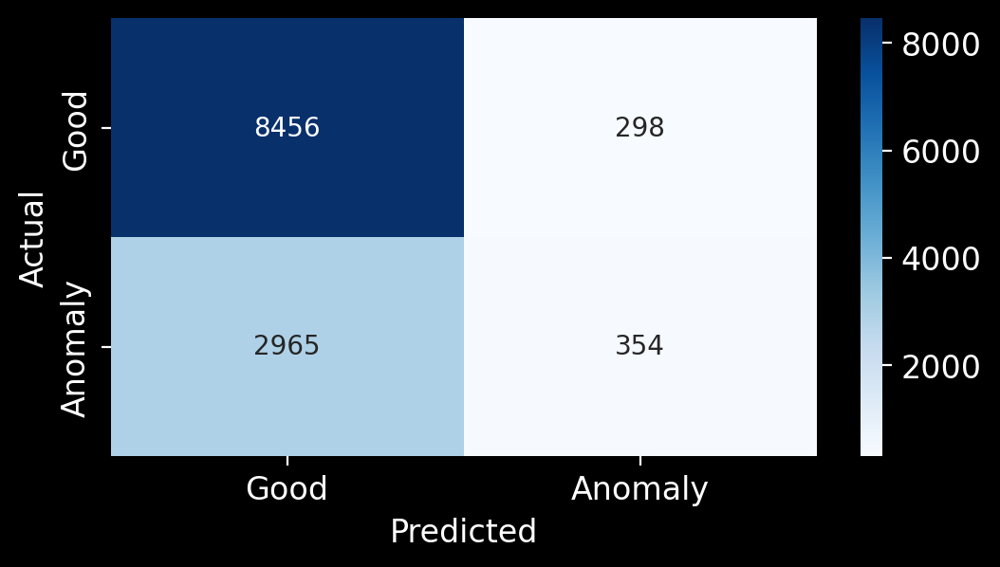

In [66]:
# Checking the performance on the training data

y_pred_train = lg.predict(train_features)
metrics_score(train_target_cat, y_pred_train)

              precision    recall  f1-score   support

       False       0.73      0.96      0.83      2147
        True       0.54      0.11      0.18       872

    accuracy                           0.72      3019
   macro avg       0.63      0.53      0.50      3019
weighted avg       0.67      0.72      0.64      3019



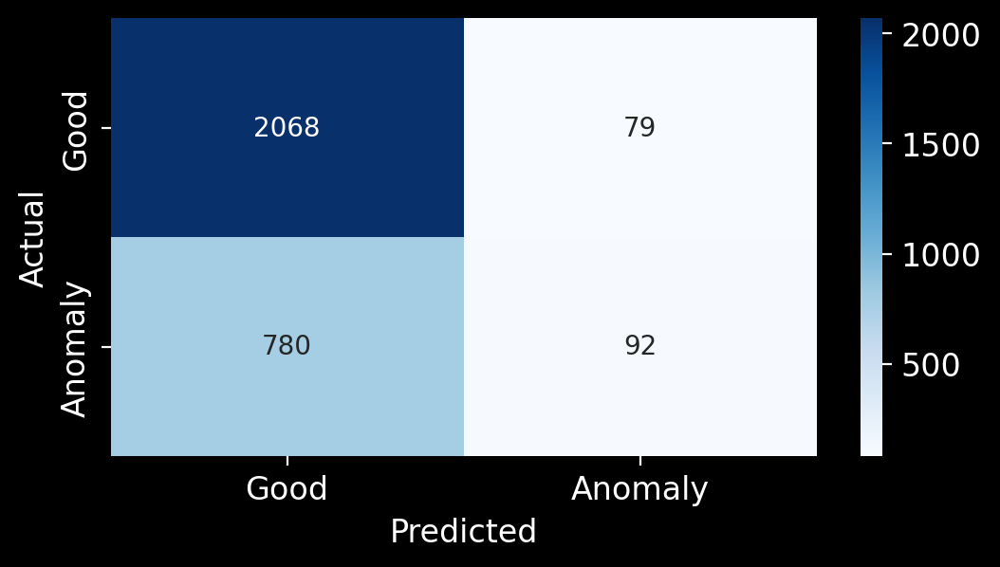

In [67]:
y_pred_test = lg.predict(test_features)
metrics_score(test_target_cat, y_pred_test)

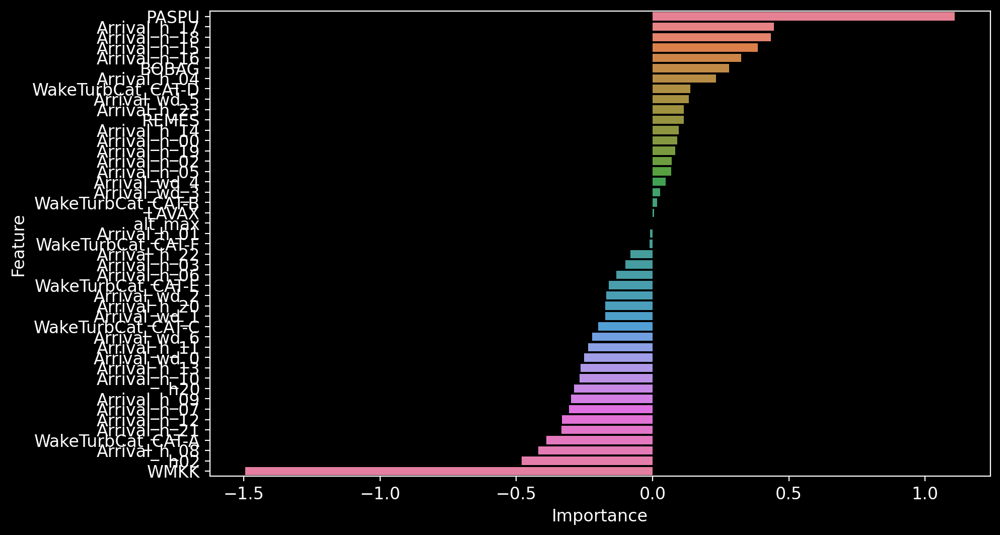

In [68]:
# Printing the coefficients of logistic regression

cols = test_features.columns

coef_lg = lg.coef_

importancedf = pd.DataFrame(coef_lg, columns=cols).T.sort_values(
    by=0, ascending=False
)

importancedf["Feature"] = importancedf.index
importancedf["Importance"] = importancedf.iloc[:, 0]

sns.barplot(y="Feature", x="Importance", data=importancedf, palette="husl")
plt.show()

### Precision-recall curve

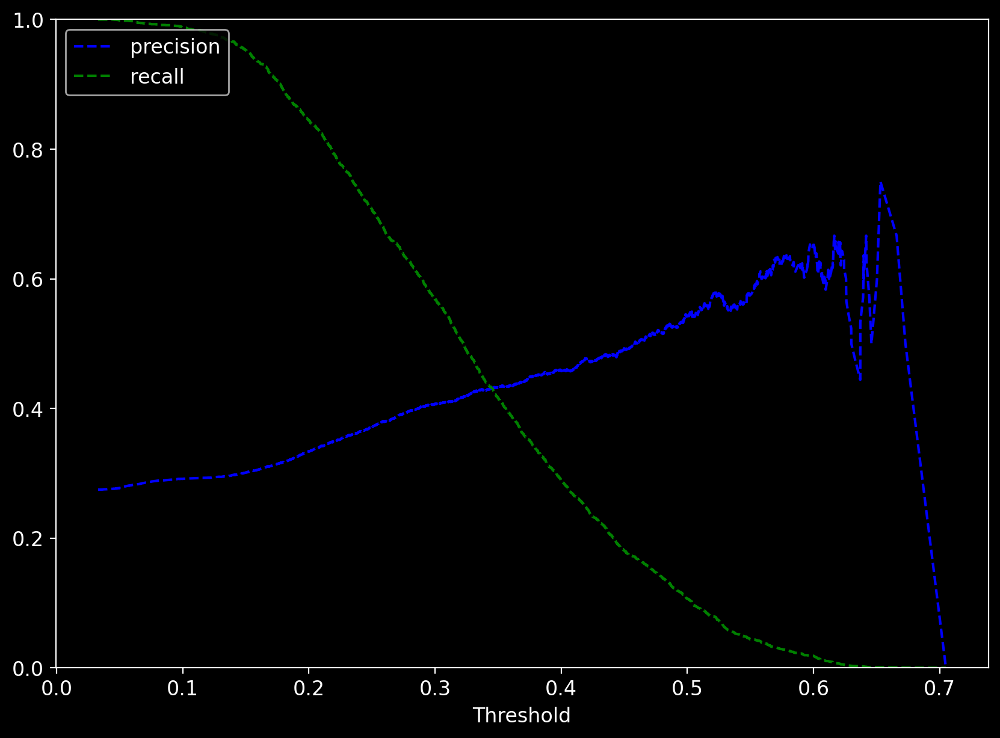

In [69]:
from sklearn.metrics import precision_recall_curve

# Predict_proba gives the probability of each observation belonging to each class

y_scores_lg = lg.predict_proba(train_features)

precisions_lg, recalls_lg, thresholds_lg = precision_recall_curve(
    train_target_cat, y_scores_lg[:, 1]
)

# Plot values of precisions, recalls, and thresholds
plt.figure(figsize=(10, 7))
plt.plot(thresholds_lg, precisions_lg[:-1], "b--", label="precision")
plt.plot(thresholds_lg, recalls_lg[:-1], "g--", label="recall")
plt.xlabel("Threshold")
plt.legend(loc="upper left")
plt.ylim([0, 1])
plt.show()

### Threshold

In [70]:
# Calculating the exact threshold where precision and recall are equal.

for i in np.arange(len(thresholds_lg)):
    if precisions_lg[i] == recalls_lg[i]:
        print(thresholds_lg[i])

0.3449011385956152
0.7050107283219813


## Performance at threshold

              precision    recall  f1-score   support

       False       0.78      0.79      0.79      8754
        True       0.43      0.42      0.43      3319

    accuracy                           0.69     12073
   macro avg       0.61      0.61      0.61     12073
weighted avg       0.69      0.69      0.69     12073



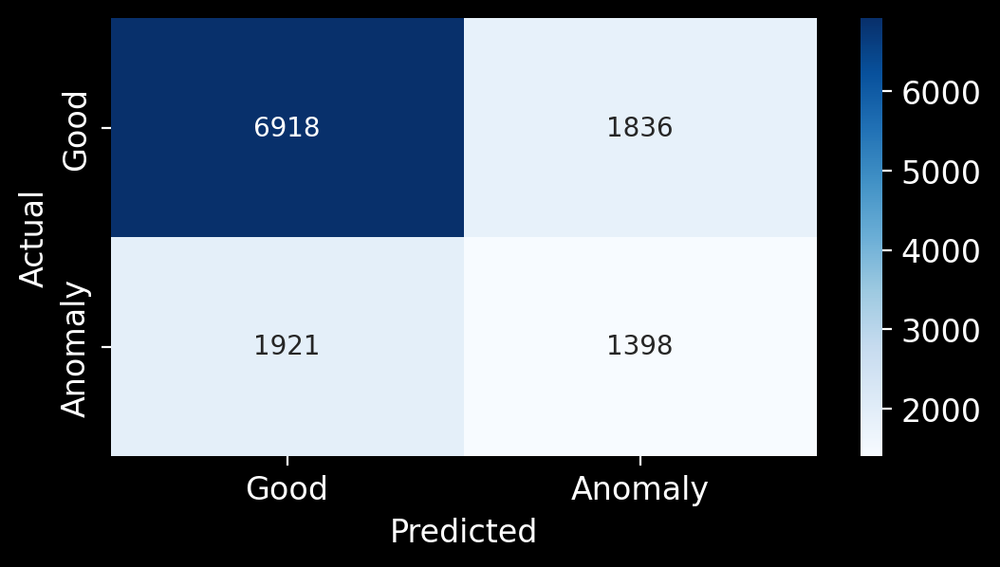

In [71]:
optimal_threshold = 0.348
y_pred_train = lg.predict_proba(train_features)
metrics_score(train_target_cat, y_pred_train[:, 1] > optimal_threshold)

              precision    recall  f1-score   support

       False       0.78      0.80      0.79      2147
        True       0.48      0.45      0.46       872

    accuracy                           0.70      3019
   macro avg       0.63      0.63      0.63      3019
weighted avg       0.69      0.70      0.70      3019



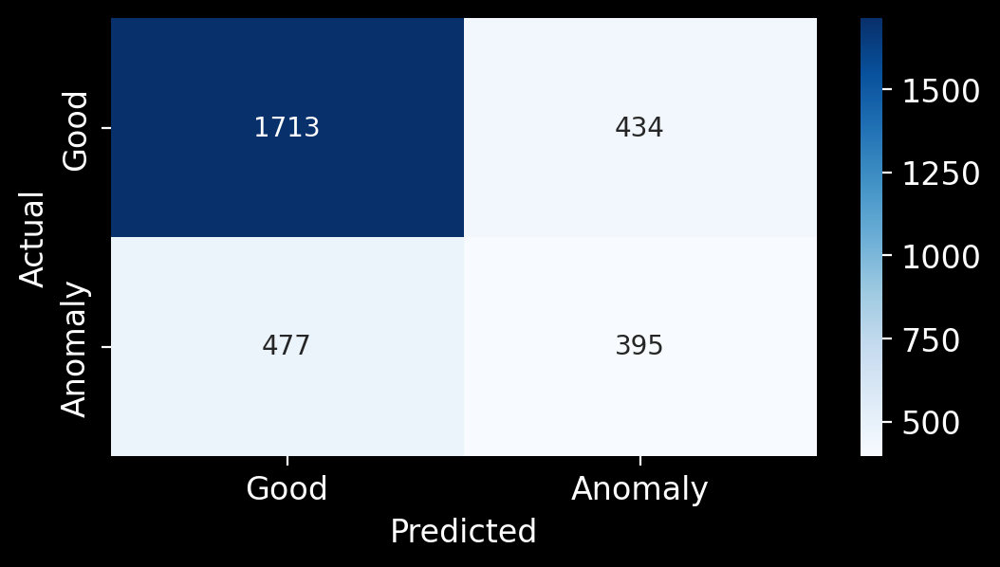

In [72]:
y_pred_test = lg.predict_proba(test_features)
metrics_score(test_target_cat, y_pred_test[:, 1] > optimal_threshold)

# SVMs: Support Vector Machines

In [73]:
# To Speed-Up SVM training, must scale

scaling = MinMaxScaler(feature_range=(-1, 1)).fit(train_features)
X_train_scaled = scaling.transform(train_features)
X_test_scaled = scaling.transform(test_features)

## SVM Linear Kernel

In [74]:
from sklearn.svm import SVC

In [75]:
# Fitting SVM
svm = SVC(
    kernel="linear", probability=True
)  # Linear kernel or linear decision boundary
model = svm.fit(X=X_train_scaled, y=train_target_cat)

              precision    recall  f1-score   support

       False       0.73      1.00      0.84      8754
        True       0.00      0.00      0.00      3319

    accuracy                           0.73     12073
   macro avg       0.36      0.50      0.42     12073
weighted avg       0.53      0.73      0.61     12073



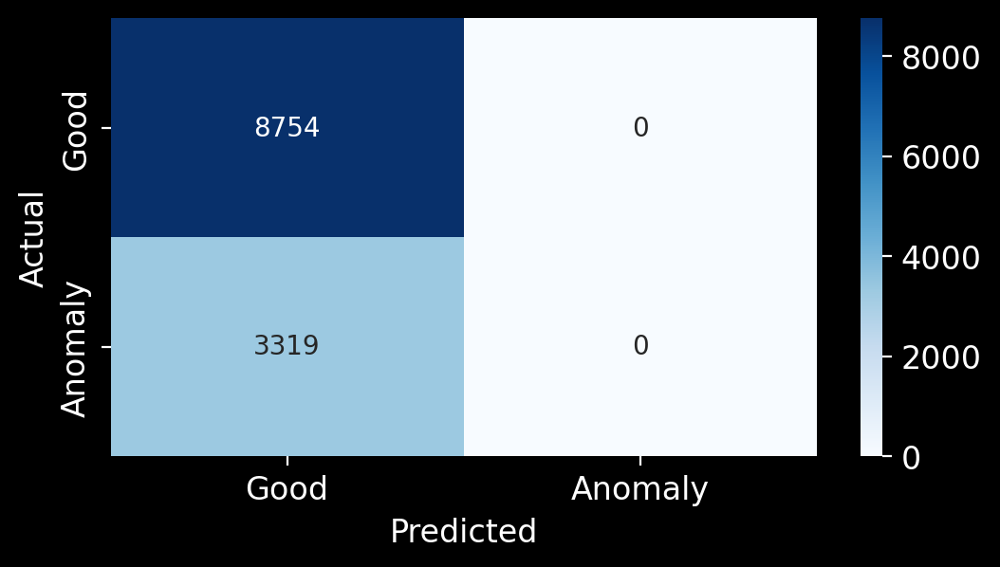

In [76]:
y_pred_train_svm = model.predict(X_train_scaled)
metrics_score(train_target_cat, y_pred_train_svm)

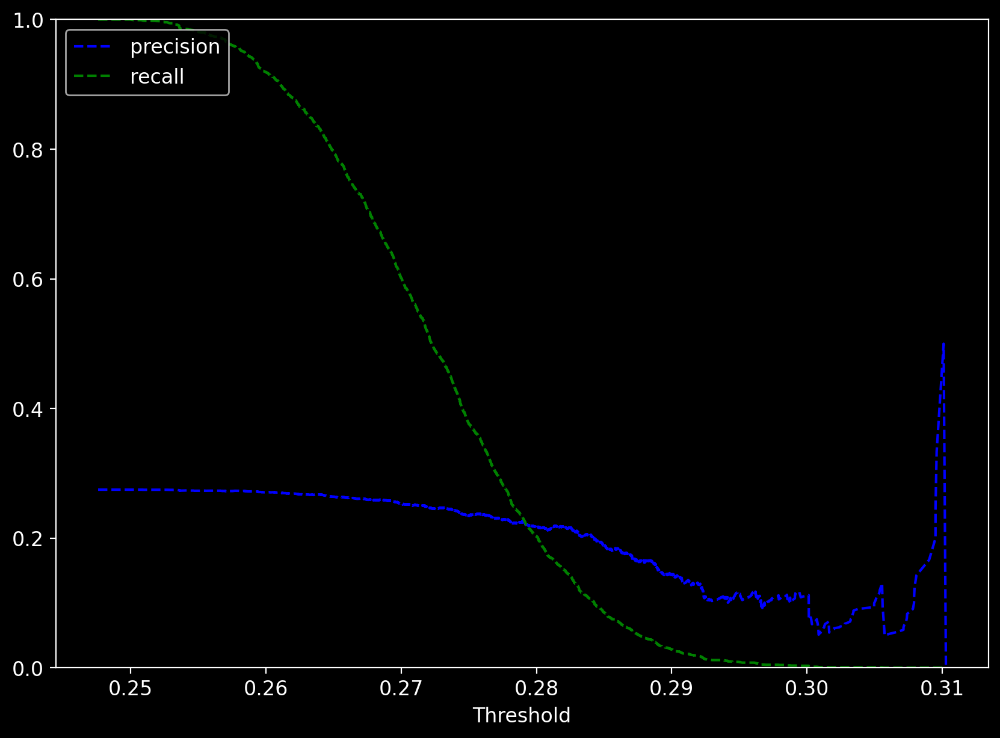

In [77]:
y_scores_svm = svm.predict_proba(X_train_scaled)


precisions_svm, recalls_svm, thresholds_svm = precision_recall_curve(
    train_target_cat, y_scores_svm[:, 1]
)

# Plot values of precisions, recalls, and thresholds
plt.figure(figsize=(10, 7))
plt.plot(thresholds_svm, precisions_svm[:-1], "b--", label="precision")
plt.plot(thresholds_svm, recalls_svm[:-1], "g--", label="recall")
plt.xlabel("Threshold")
plt.legend(loc="upper left")
plt.ylim([0, 1])
plt.show()

In [78]:
# Calculating the exact threshold where precision and recall are equal.
for i in np.arange(len(thresholds_svm)):
    if precisions_svm[i] == recalls_svm[i]:
        print(thresholds_svm[i])

0.27925474598495775
0.3102657993352762


              precision    recall  f1-score   support

       False       0.71      0.79      0.75      8754
        True       0.22      0.15      0.18      3319

    accuracy                           0.62     12073
   macro avg       0.46      0.47      0.46     12073
weighted avg       0.58      0.62      0.59     12073



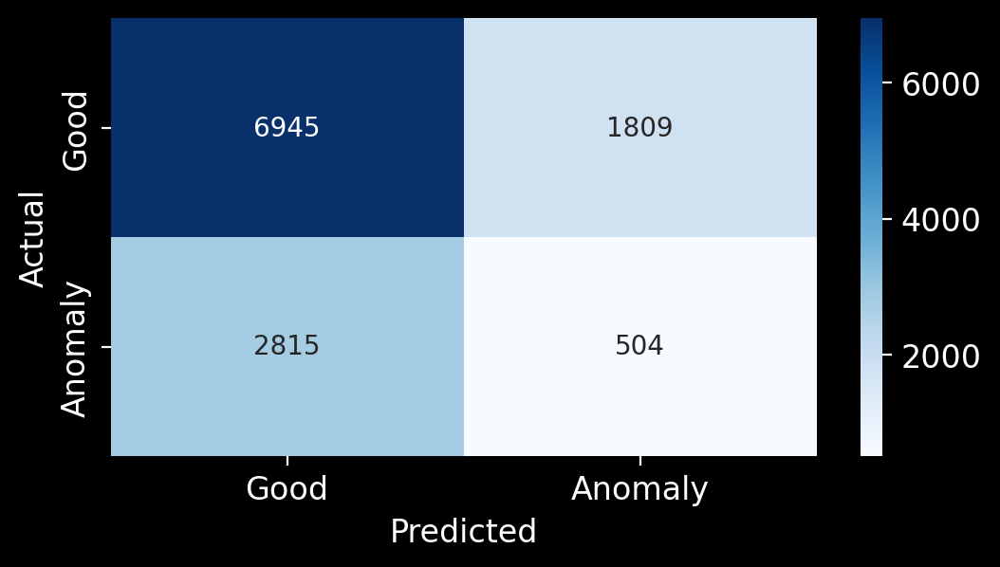

In [79]:
optimal_threshold = 0.282
y_pred_train = svm.predict_proba(X_train_scaled)
metrics_score(train_target_cat, y_pred_train[:, 1] > optimal_threshold)

              precision    recall  f1-score   support

       False       0.71      0.79      0.75      8754
        True       0.22      0.15      0.18      3319

    accuracy                           0.62     12073
   macro avg       0.46      0.47      0.46     12073
weighted avg       0.58      0.62      0.59     12073



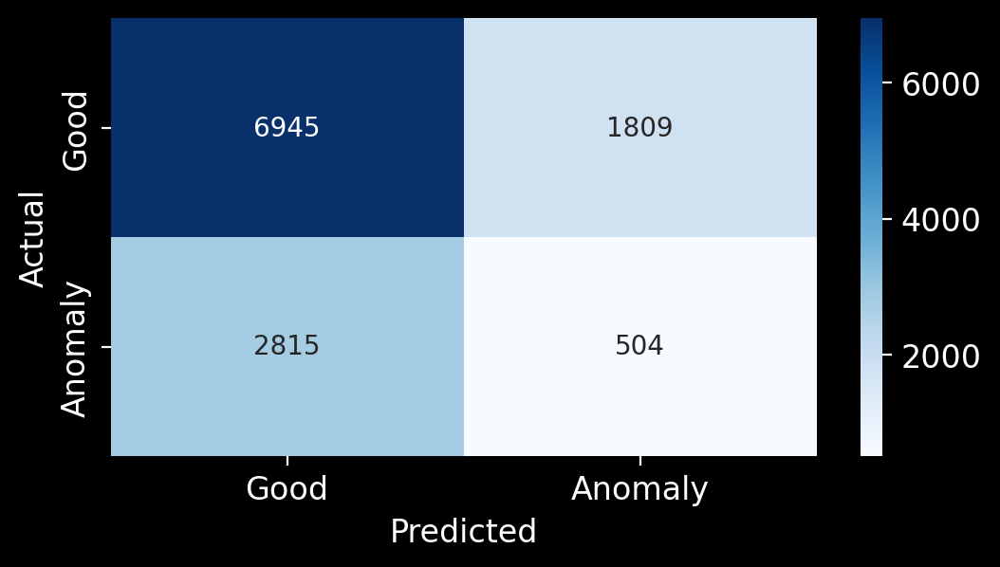

In [80]:
y_pred_test = svm.predict_proba(X_train_scaled)
metrics_score(train_target_cat, y_pred_test[:, 1] > optimal_threshold)

## SVM RBF Kernel

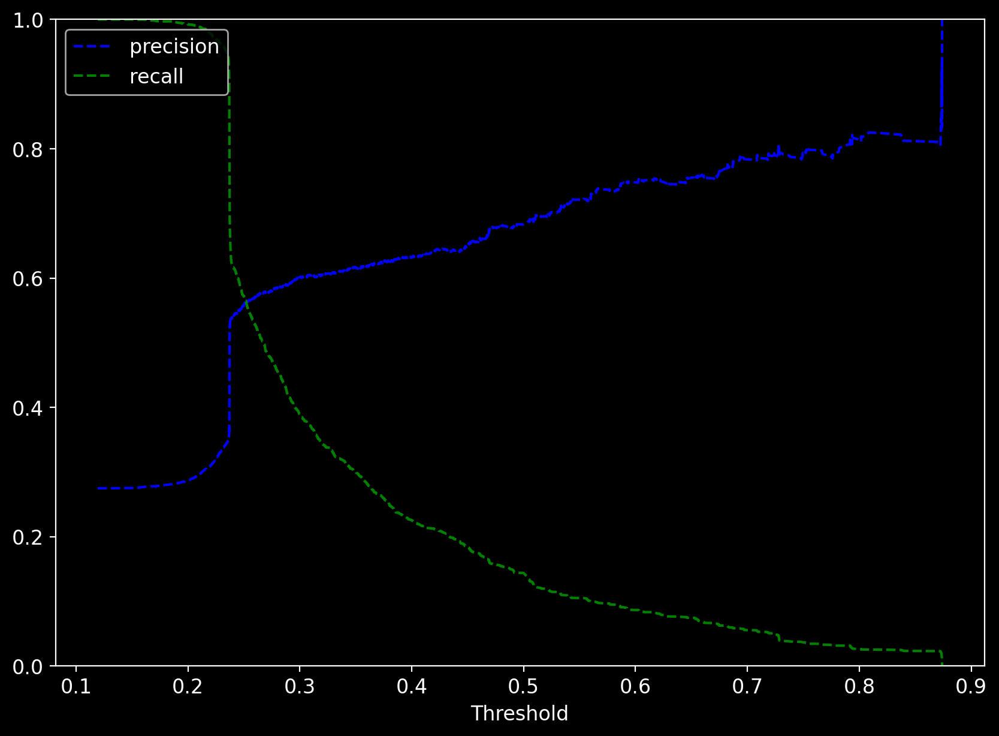

In [81]:
svm_rbf = SVC(kernel="rbf", probability=True)
svm_rbf.fit(X_train_scaled, train_target_cat)
y_scores_svm = svm_rbf.predict_proba(
    X_train_scaled
)  # Predict_proba gives the probability of each observation belonging to each class


precisions_svm, recalls_svm, thresholds_svm = precision_recall_curve(
    train_target_cat, y_scores_svm[:, 1]
)

# Plot values of precisions, recalls, and thresholds
plt.figure(figsize=(10, 7))
plt.plot(thresholds_svm, precisions_svm[:-1], "b--", label="precision")
plt.plot(thresholds_svm, recalls_svm[:-1], "g--", label="recall")
plt.xlabel("Threshold")
plt.legend(loc="upper left")
plt.ylim([0, 1])
plt.show()

In [82]:
# Calculating the exact threshold where precision and recall are equal.
for i in np.arange(len(thresholds_svm)):
    if precisions_svm[i] == recalls_svm[i]:
        print(thresholds_svm[i])

0.25193011776489893


              precision    recall  f1-score   support

       False       0.83      0.84      0.83      8754
        True       0.56      0.56      0.56      3319

    accuracy                           0.76     12073
   macro avg       0.70      0.70      0.70     12073
weighted avg       0.76      0.76      0.76     12073



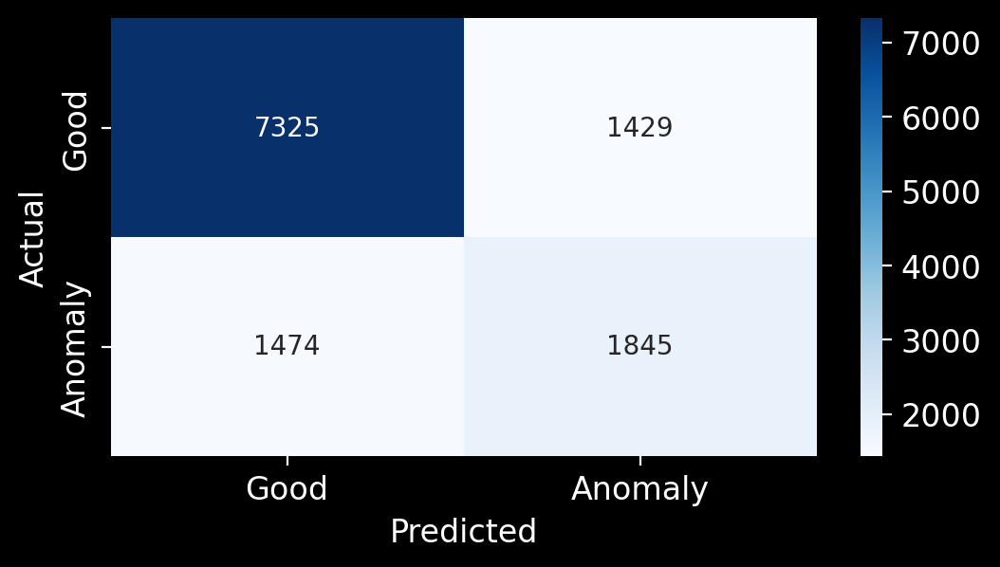

In [83]:
optimal_threshold1 = 0.253
y_pred_train = svm_rbf.predict_proba(X_train_scaled)

metrics_score(train_target_cat, y_pred_train[:, 1] > optimal_threshold1)

              precision    recall  f1-score   support

       False       0.79      0.77      0.78      2147
        True       0.46      0.48      0.47       872

    accuracy                           0.69      3019
   macro avg       0.62      0.63      0.62      3019
weighted avg       0.69      0.69      0.69      3019



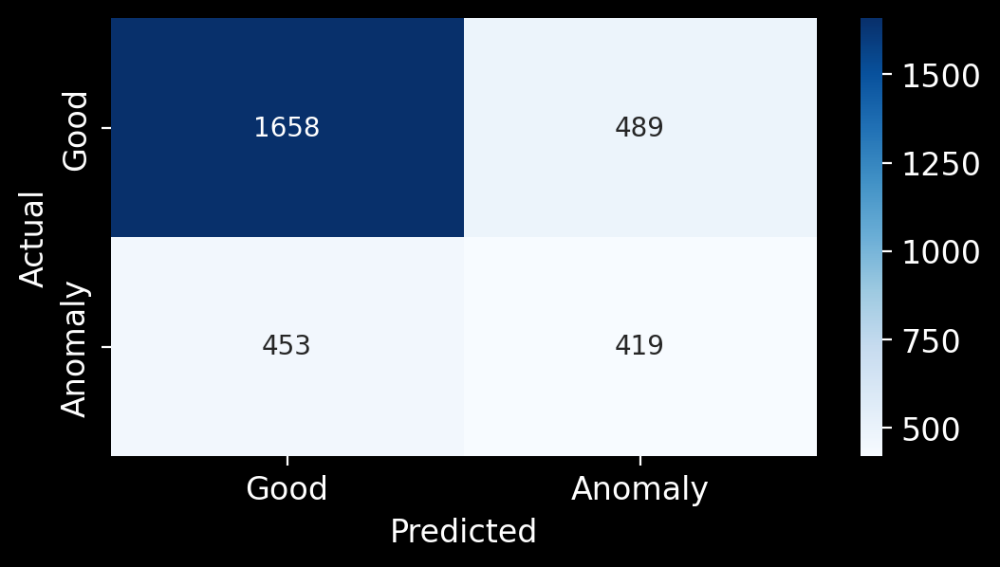

In [84]:
y_pred_test = svm_rbf.predict_proba(X_test_scaled)

metrics_score(test_target_cat, y_pred_test[:, 1] > optimal_threshold1)

# Decision tree

In [85]:
# To build classification models
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier

In [86]:
# train_features,
# test_features,
# train_target_cat,
# test_target_cat,

In [87]:
# Building decision tree model

model_dt = DecisionTreeClassifier(random_state=1, max_depth=8)
model_dt.fit(train_features, train_target_cat)

DecisionTreeClassifier(max_depth=8, random_state=1)

              precision    recall  f1-score   support

       False       0.76      0.95      0.84      8754
        True       0.61      0.20      0.30      3319

    accuracy                           0.74     12073
   macro avg       0.68      0.57      0.57     12073
weighted avg       0.72      0.74      0.69     12073



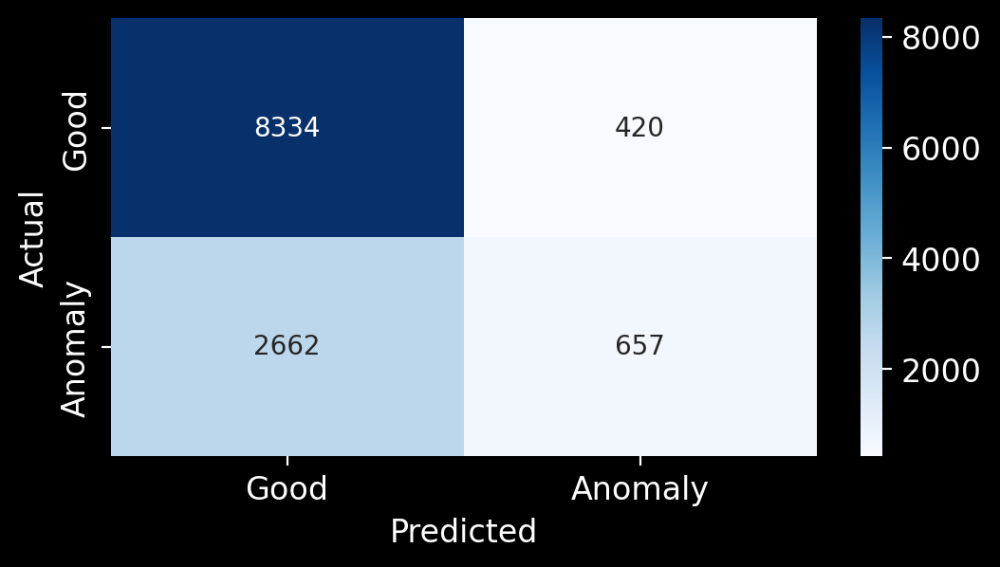

In [88]:
# Model performance on training dataset

pred_train_target_cat = model_dt.predict(train_features)
metrics_score(train_target_cat, pred_train_target_cat)

              precision    recall  f1-score   support

       False       0.74      0.93      0.82      2147
        True       0.53      0.18      0.27       872

    accuracy                           0.72      3019
   macro avg       0.63      0.56      0.55      3019
weighted avg       0.68      0.72      0.66      3019



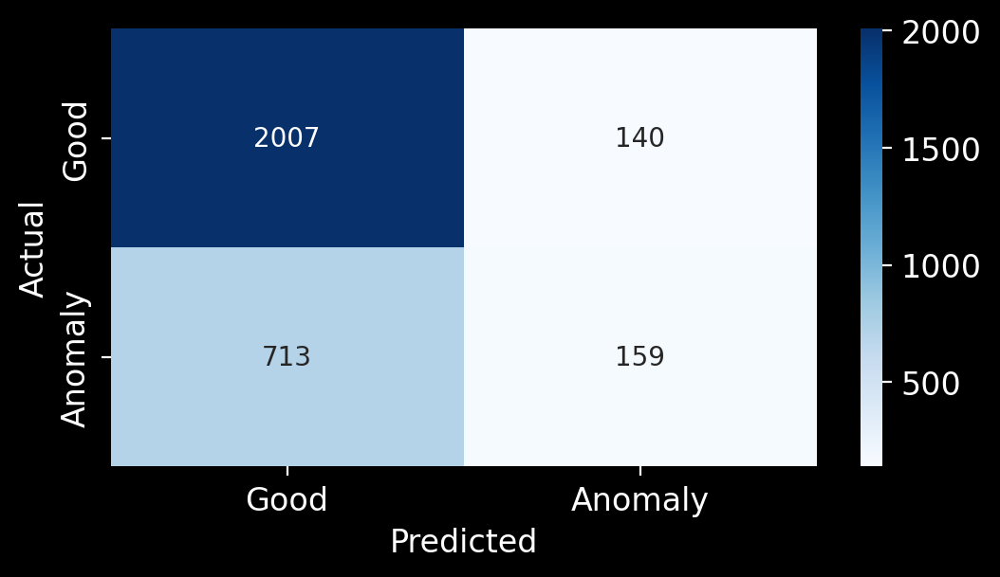

In [89]:
# Model performance on testing dataset

pred_test_target_cat = model_dt.predict(test_features)
metrics_score(test_target_cat, pred_test_target_cat)

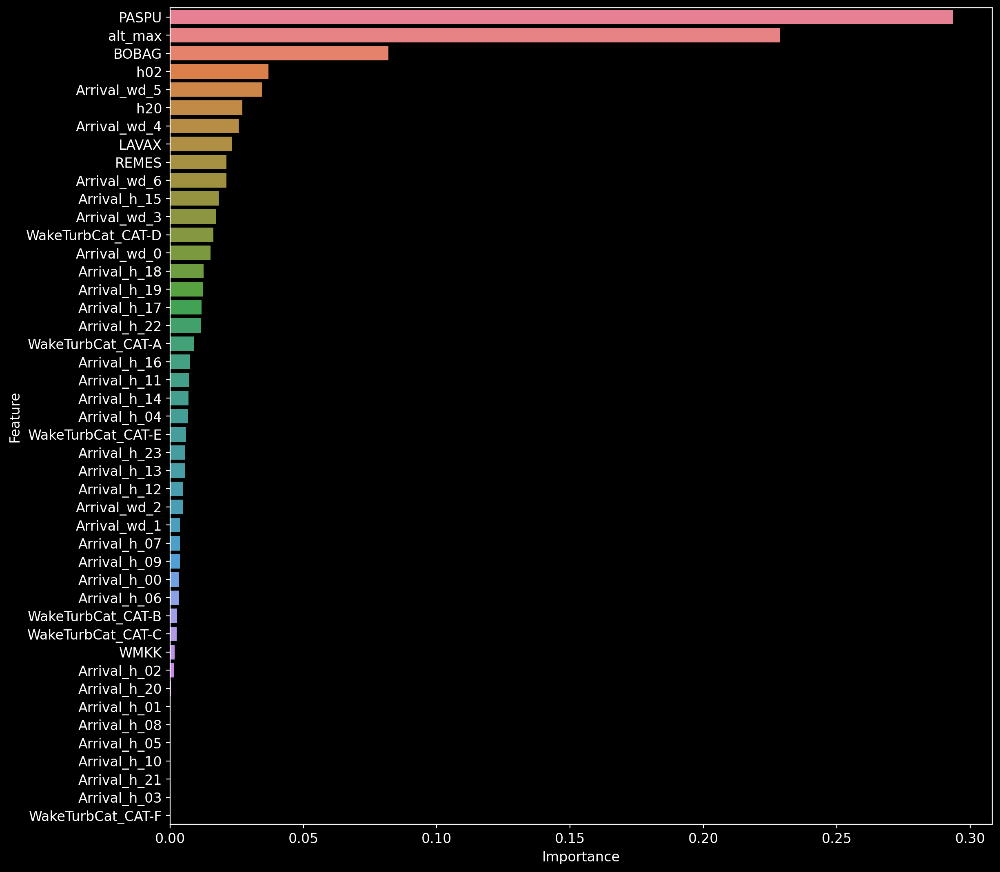

In [90]:
# Importance of features in the tree building

feature_names = list(train_features.columns)
importances = model_dt.feature_importances_
indices = np.argsort(importances)


names = [feature_names[i] for i in indices]
importancedf = pd.DataFrame(
    {"Feature": names, "Importance": importances[indices]}
).sort_values(by="Importance", ascending=False)

plt.figure(figsize=(13, 13))
sns.barplot(y="Feature", x="Importance", data=importancedf, palette="husl")
plt.show()

## Prunning the tree

In [91]:
from sklearn import metrics

# For tuning the model
from sklearn.model_selection import GridSearchCV

In [92]:
# Choose the type of classifier
dtree_estimator = DecisionTreeClassifier(
    class_weight="balanced", random_state=1
)

# Grid of parameters to choose from
parameters = {
    "max_depth": np.arange(2, 10),
    "criterion": ["gini", "entropy"],
    "min_samples_leaf": [50, 100, 200, 300, 500, 750, 1000],
}

# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(recall_score, pos_label=1)

# Run the grid search
gridCV = GridSearchCV(dtree_estimator, parameters, scoring=scorer, cv=10)

# Fitting the grid search on the train data
gridCV = gridCV.fit(train_features, train_target_cat)

# Set the classifier to the best combination of parameters
dtree_estimator = gridCV.best_estimator_

In [93]:
gridCV.best_params_

{'criterion': 'gini', 'max_depth': 9, 'min_samples_leaf': 300}

In [94]:
# Fit the best estimator to the data
dtree_estimator.fit(train_features, train_target_cat)

DecisionTreeClassifier(class_weight='balanced', max_depth=9,
                       min_samples_leaf=300, random_state=1)

              precision    recall  f1-score   support

       False       0.84      0.56      0.67      8754
        True       0.38      0.71      0.50      3319

    accuracy                           0.60     12073
   macro avg       0.61      0.64      0.59     12073
weighted avg       0.71      0.60      0.63     12073



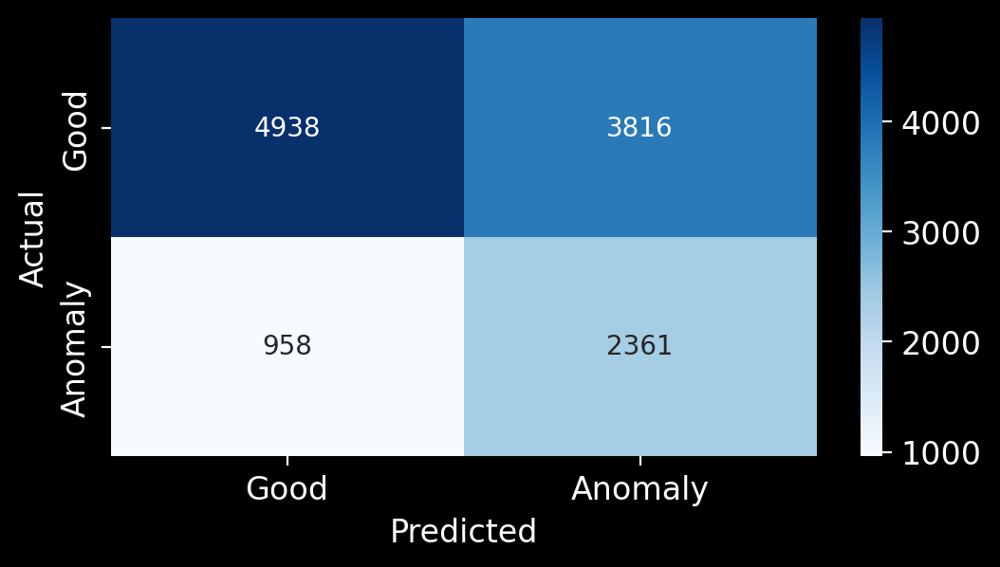

In [95]:
# Model performance on training dataset

pred_train_target_cat = dtree_estimator.predict(train_features)
metrics_score(train_target_cat, pred_train_target_cat)

              precision    recall  f1-score   support

       False       0.83      0.57      0.68      2147
        True       0.41      0.72      0.52       872

    accuracy                           0.61      3019
   macro avg       0.62      0.65      0.60      3019
weighted avg       0.71      0.61      0.63      3019



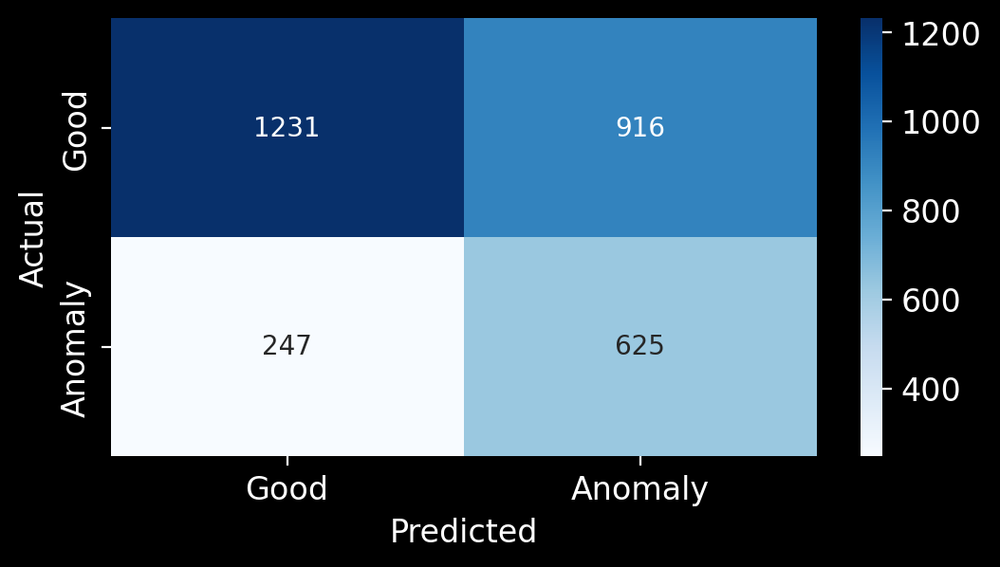

In [96]:
# Model performance on testing dataset

pred_test_target_cat = dtree_estimator.predict(test_features)
metrics_score(test_target_cat, pred_test_target_cat)

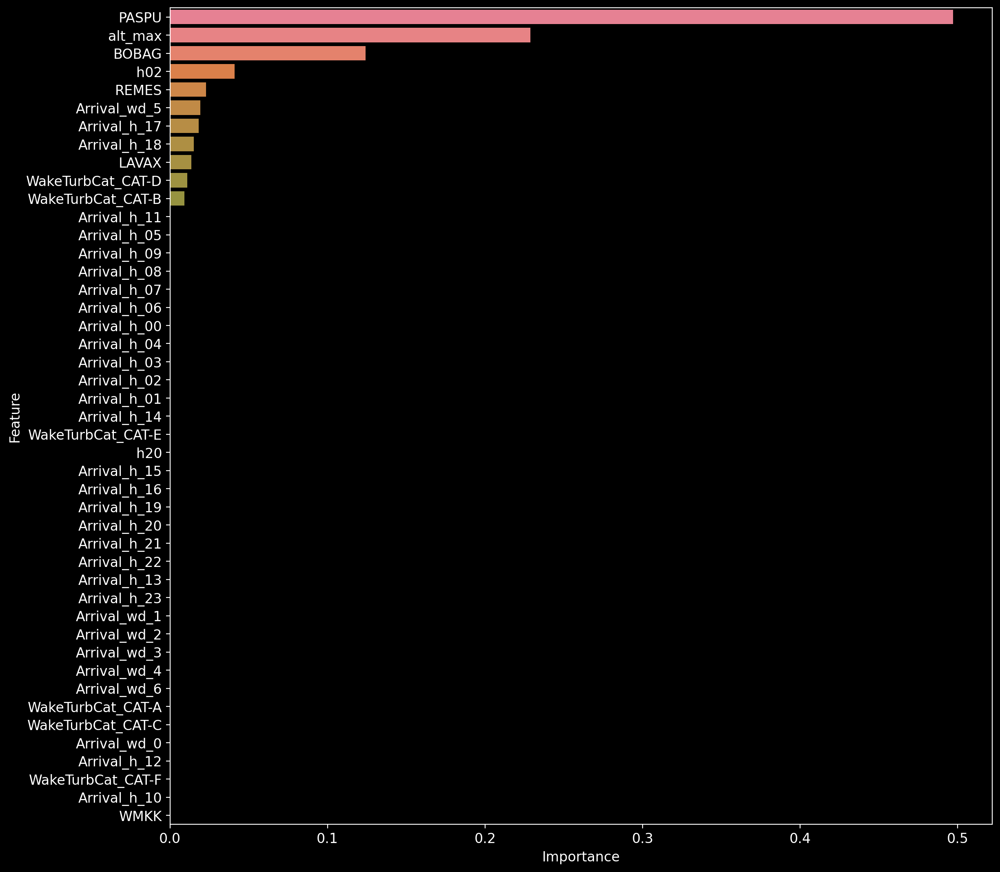

In [97]:
# Importance of features in the tree building

feature_names = list(train_features.columns)
importances = dtree_estimator.feature_importances_
indices = np.argsort(importances)


names = [feature_names[i] for i in indices]
importancedf = pd.DataFrame(
    {"Feature": names, "Importance": importances[indices]}
).sort_values(by="Importance", ascending=False)

plt.figure(figsize=(13, 13))
sns.barplot(y="Feature", x="Importance", data=importancedf, palette="husl")
plt.show()

### Cross validation

In [98]:
from sklearn.model_selection import cross_val_score


scores = cross_val_score(
    dtree_estimator, train_features, train_target_cat, cv=5
)
print(
    f"The average score of the model with K-5 Cross validation is {np.average(scores)} "
)

The average score of the model with K-5 Cross validation is 0.608296874169141 


## Scaled decision-tree

              precision    recall  f1-score   support

       False       0.96      1.00      0.98      8754
        True       0.99      0.89      0.94      3319

    accuracy                           0.97     12073
   macro avg       0.98      0.94      0.96     12073
weighted avg       0.97      0.97      0.97     12073



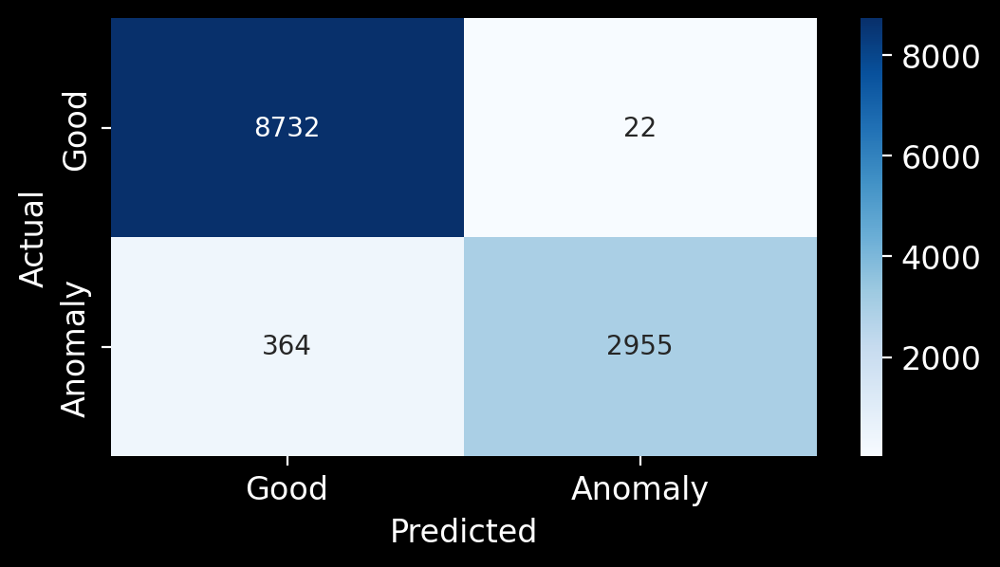

In [99]:
dt = DecisionTreeClassifier(random_state=1)
X_train_std = scaler.fit_transform(train_features)
X_test_std = scaler.transform(test_features)
dt.fit(X_train_std, train_target_cat)
y_train_pred_dt = dt.predict(X_train_std)
metrics_score(train_target_cat, y_train_pred_dt)

              precision    recall  f1-score   support

       False       0.76      0.79      0.78      2147
        True       0.43      0.39      0.41       872

    accuracy                           0.68      3019
   macro avg       0.60      0.59      0.59      3019
weighted avg       0.67      0.68      0.67      3019



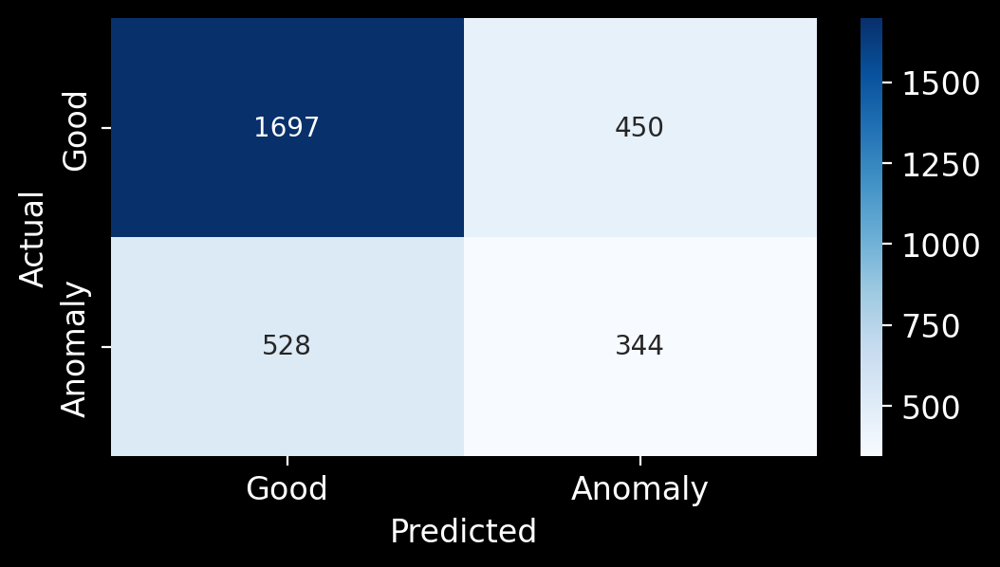

In [100]:
y_test_pred_dt = dt.predict(X_test_std)
metrics_score(test_target_cat, y_test_pred_dt)

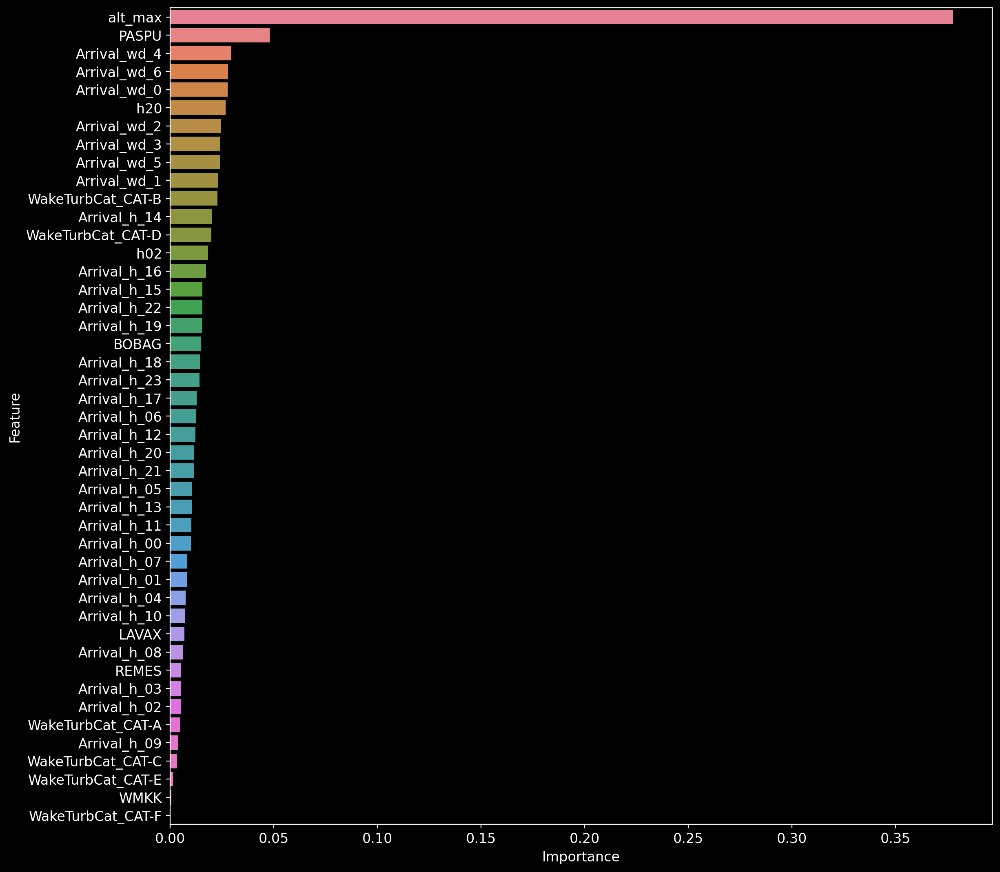

In [101]:
# Importance of features in the tree building

feature_names = list(train_features.columns)
importances = dt.feature_importances_
indices = np.argsort(importances)


names = [feature_names[i] for i in indices]
importancedf = pd.DataFrame(
    {"Feature": names, "Importance": importances[indices]}
).sort_values(by="Importance", ascending=False)

plt.figure(figsize=(13, 13))
sns.barplot(y="Feature", x="Importance", data=importancedf, palette="husl")
plt.show()

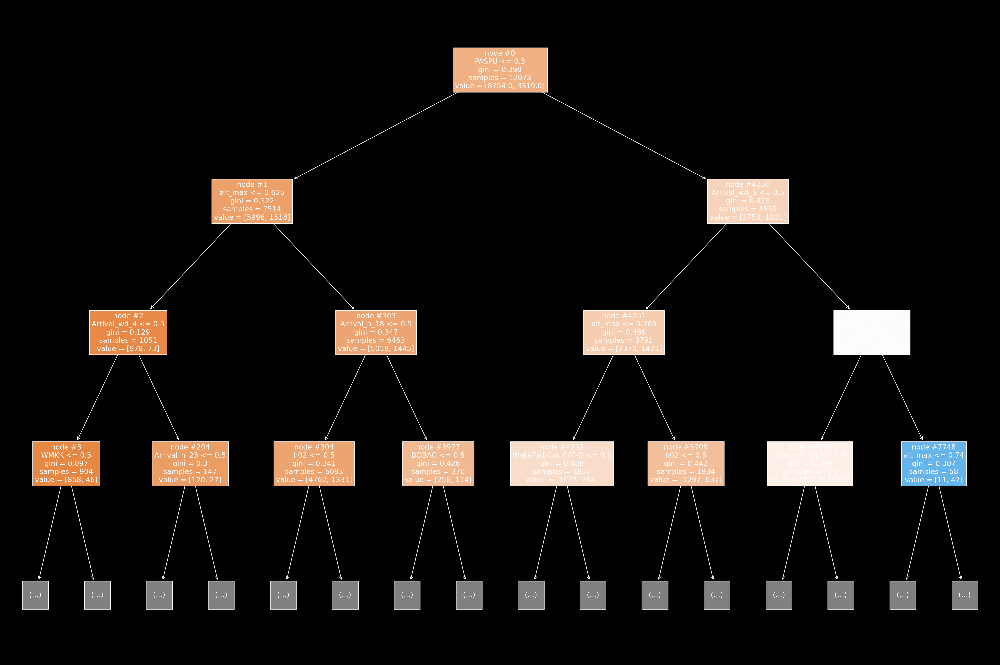

In [102]:
from sklearn.tree import plot_tree


features = list(train_features.columns)
plt.figure(figsize=(30, 20))
plot_tree(
    dt,
    max_depth=3,
    feature_names=features,
    filled=True,
    fontsize=12,
    node_ids=True,
    class_names=None,
)
plt.show()

# Random forest classifier

In [103]:
# Fitting the Random Forest classifier on the training data
rf_estimator = RandomForestClassifier(random_state=1)

rf_estimator.fit(train_features, train_target_cat)

RandomForestClassifier(random_state=1)

              precision    recall  f1-score   support

       False       0.97      0.99      0.98      8754
        True       0.97      0.92      0.94      3319

    accuracy                           0.97     12073
   macro avg       0.97      0.96      0.96     12073
weighted avg       0.97      0.97      0.97     12073



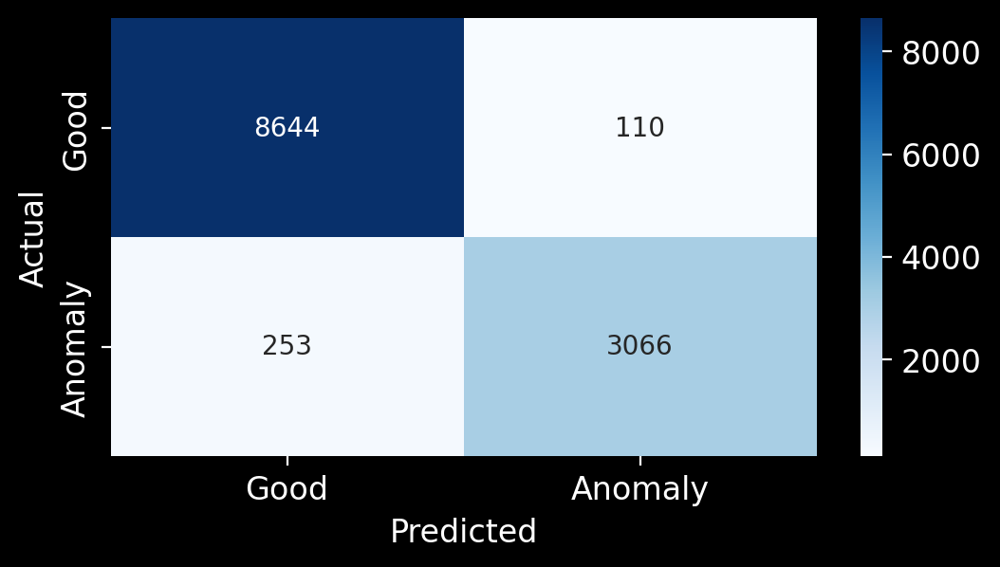

In [104]:
# Model performance on training dataset

pred_train_target_cat = rf_estimator.predict(train_features)
metrics_score(train_target_cat, pred_train_target_cat)

              precision    recall  f1-score   support

       False       0.76      0.85      0.80      2147
        True       0.48      0.35      0.41       872

    accuracy                           0.70      3019
   macro avg       0.62      0.60      0.60      3019
weighted avg       0.68      0.70      0.69      3019



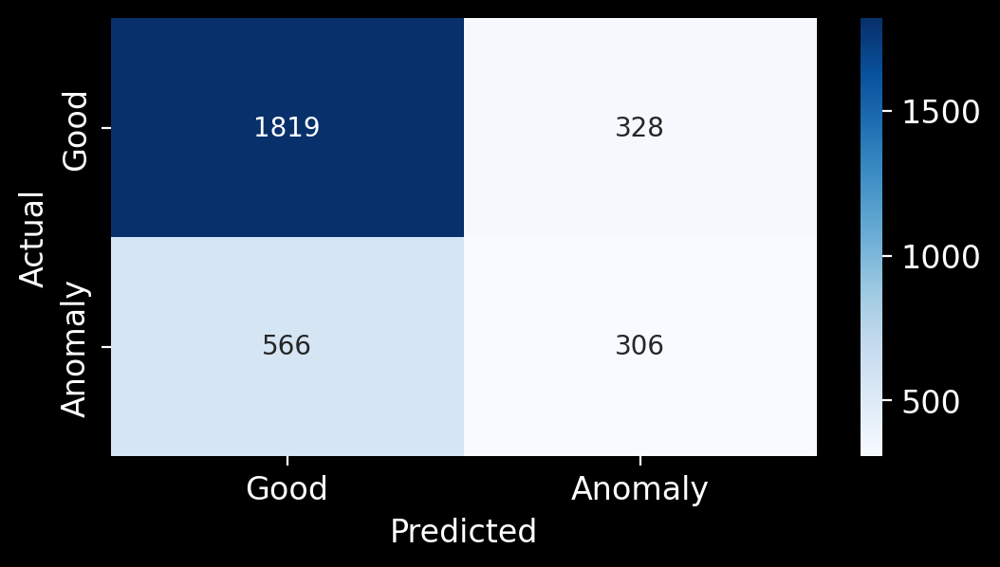

In [105]:
# Model performance on testing dataset

pred_test_target_cat = rf_estimator.predict(test_features)
metrics_score(test_target_cat, pred_test_target_cat)

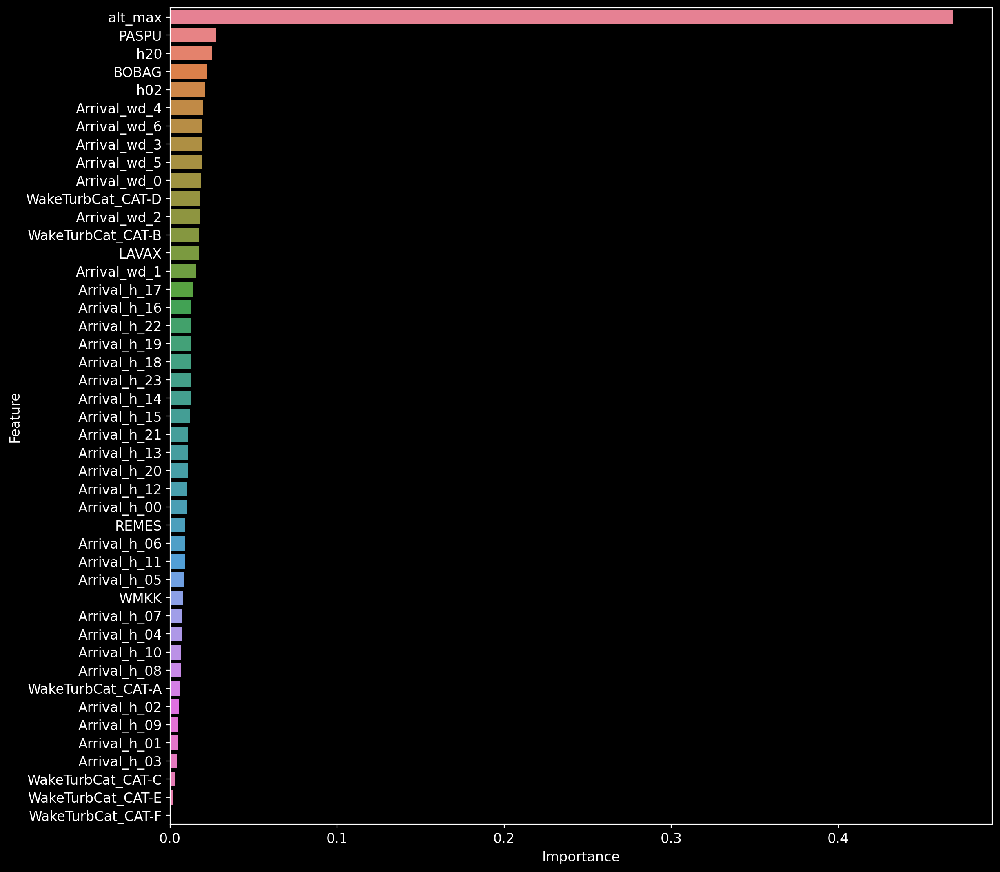

In [106]:
# Importance of features in the random forest

feature_names = list(train_features.columns)
importances = rf_estimator.feature_importances_
indices = np.argsort(importances)

names = [feature_names[i] for i in indices]
importancedf = pd.DataFrame(
    {"Feature": names, "Importance": importances[indices]}
).sort_values(by="Importance", ascending=False)

plt.figure(figsize=(13, 13))
sns.barplot(y="Feature", x="Importance", data=importancedf, palette="husl")
plt.show()

## Prunning random forest

In [107]:
# Choose the type of classifier
rf_estimator_tuned = RandomForestClassifier(
    class_weight="balanced", random_state=1
)

# Grid of parameters to choose from
params_rf = {
    "max_features": [0.3, 0.5, 0.7, 0.9, "auto"],
    "min_samples_leaf": [25, 50, 75, 100, 200],
    "n_estimators": [25, 50, 75, 100, 200],
}

# Type of scoring used to compare parameter combinations
scorer = metrics.make_scorer(recall_score, pos_label=1)

# Run the grid search
grid_obj = GridSearchCV(rf_estimator_tuned, params_rf, scoring=scorer, cv=5)

# Fitting the grid search on the train data
grid_obj = grid_obj.fit(train_features, train_target_cat)

# Set the classifier to the best combination of parameters
rf_estimator_tuned = grid_obj.best_estimator_

In [108]:
grid_obj.best_params_

{'max_features': 0.3, 'min_samples_leaf': 50, 'n_estimators': 75}

In [109]:
rf_estimator_tuned.fit(train_features, train_target_cat)

RandomForestClassifier(class_weight='balanced', max_features=0.3,
                       min_samples_leaf=50, n_estimators=75, random_state=1)

              precision    recall  f1-score   support

       False       0.85      0.62      0.72      8754
        True       0.41      0.70      0.52      3319

    accuracy                           0.64     12073
   macro avg       0.63      0.66      0.62     12073
weighted avg       0.73      0.64      0.66     12073



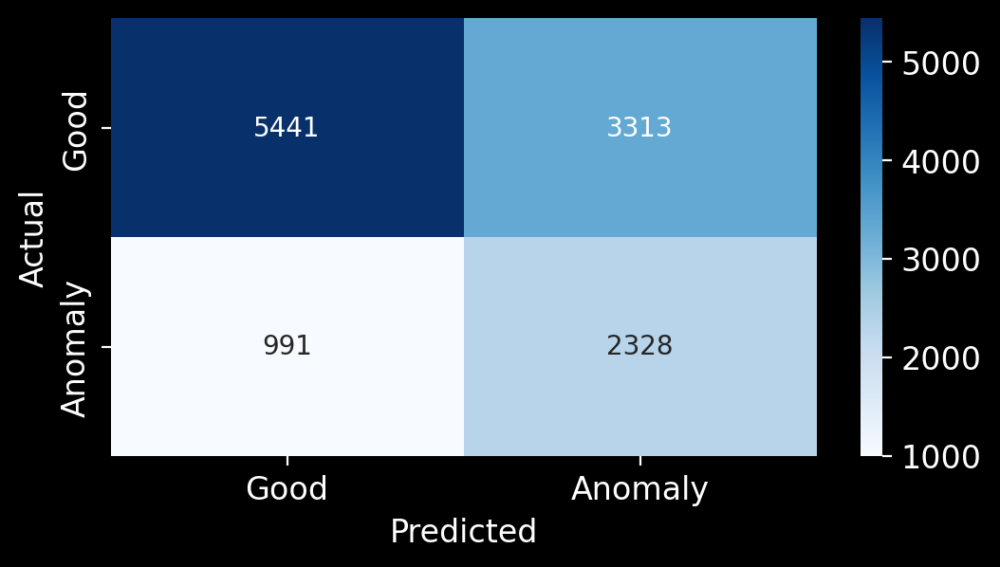

In [110]:
# Checking performance on the training data

y_pred_train_rf_tuned = rf_estimator_tuned.predict(train_features)
metrics_score(train_target_cat, y_pred_train_rf_tuned)

              precision    recall  f1-score   support

       False       0.84      0.63      0.72      2147
        True       0.43      0.71      0.54       872

    accuracy                           0.65      3019
   macro avg       0.64      0.67      0.63      3019
weighted avg       0.72      0.65      0.67      3019



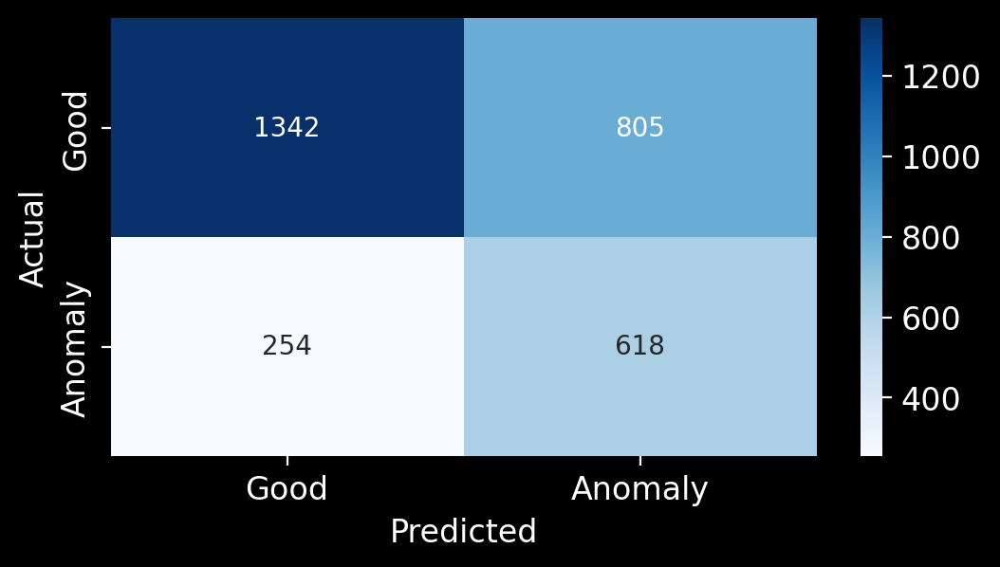

In [111]:
# Checking performance on the test data

y_pred_test_rf_tuned = rf_estimator_tuned.predict(test_features)
metrics_score(test_target_cat, y_pred_test_rf_tuned)

### Feature importance

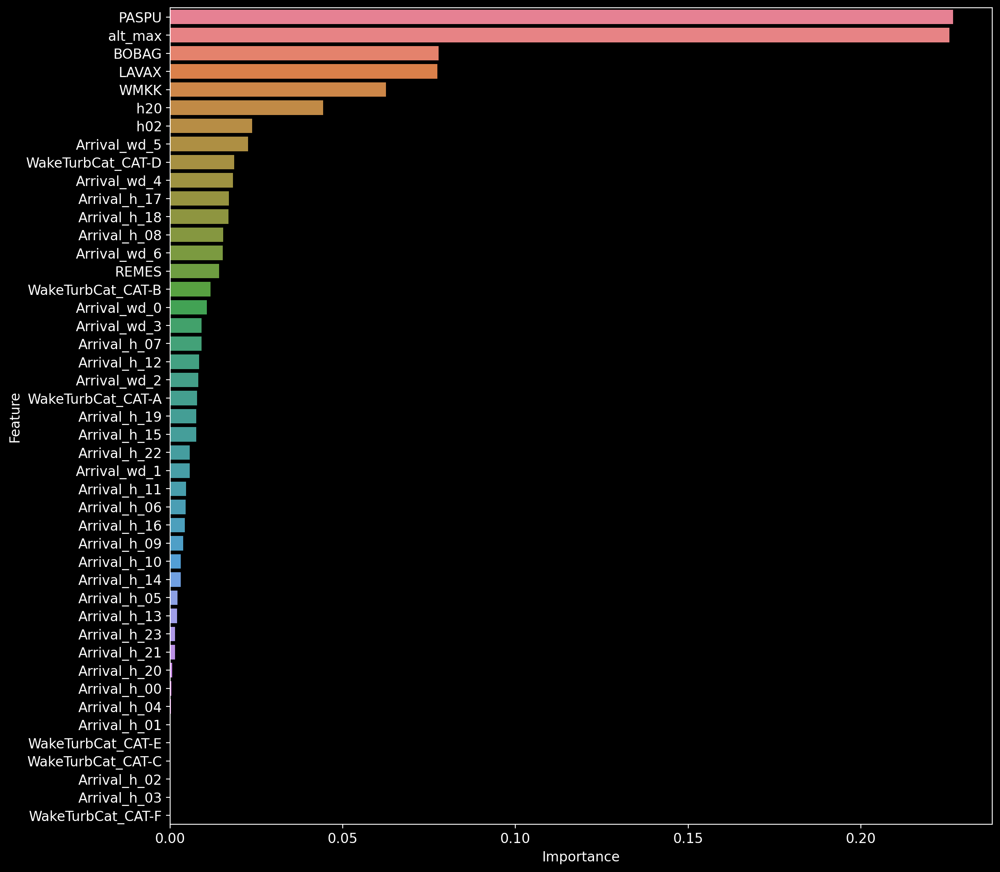

In [112]:
# Importance of features in the random forest

feature_names = list(train_features.columns)
importances = rf_estimator_tuned.feature_importances_
indices = np.argsort(importances)

names = [feature_names[i] for i in indices]
importancedf = pd.DataFrame(
    {"Feature": names, "Importance": importances[indices]}
).sort_values(by="Importance", ascending=False)

plt.figure(figsize=(13, 13))
sns.barplot(y="Feature", x="Importance", data=importancedf, palette="husl")
plt.show()

## Random Forest on the regression feature selection

In [113]:
# Fitting the Random Forest classifier on the training data
rf_estimator_subset = RandomForestClassifier(random_state=1)

rf_estimator_subset.fit(train_features_scaled_new_2, train_target_cat)

RandomForestClassifier(random_state=1)

              precision    recall  f1-score   support

       False       0.75      0.96      0.84      8754
        True       0.58      0.15      0.23      3319

    accuracy                           0.74     12073
   macro avg       0.66      0.55      0.54     12073
weighted avg       0.70      0.74      0.67     12073



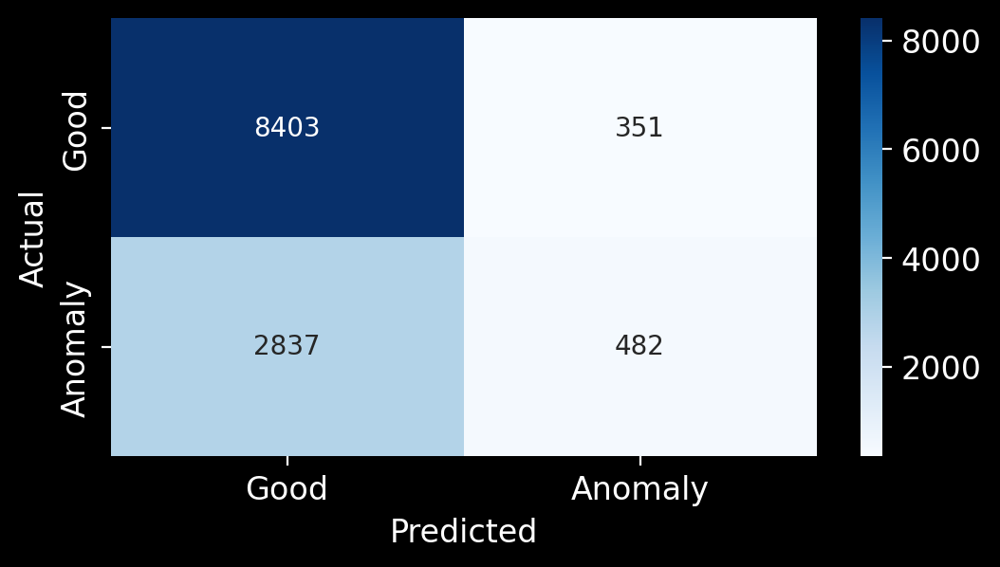

In [114]:
# Model performance on training dataset

pred_train_target_cat = rf_estimator_subset.predict(
    train_features_scaled_new_2
)
metrics_score(train_target_cat, pred_train_target_cat)

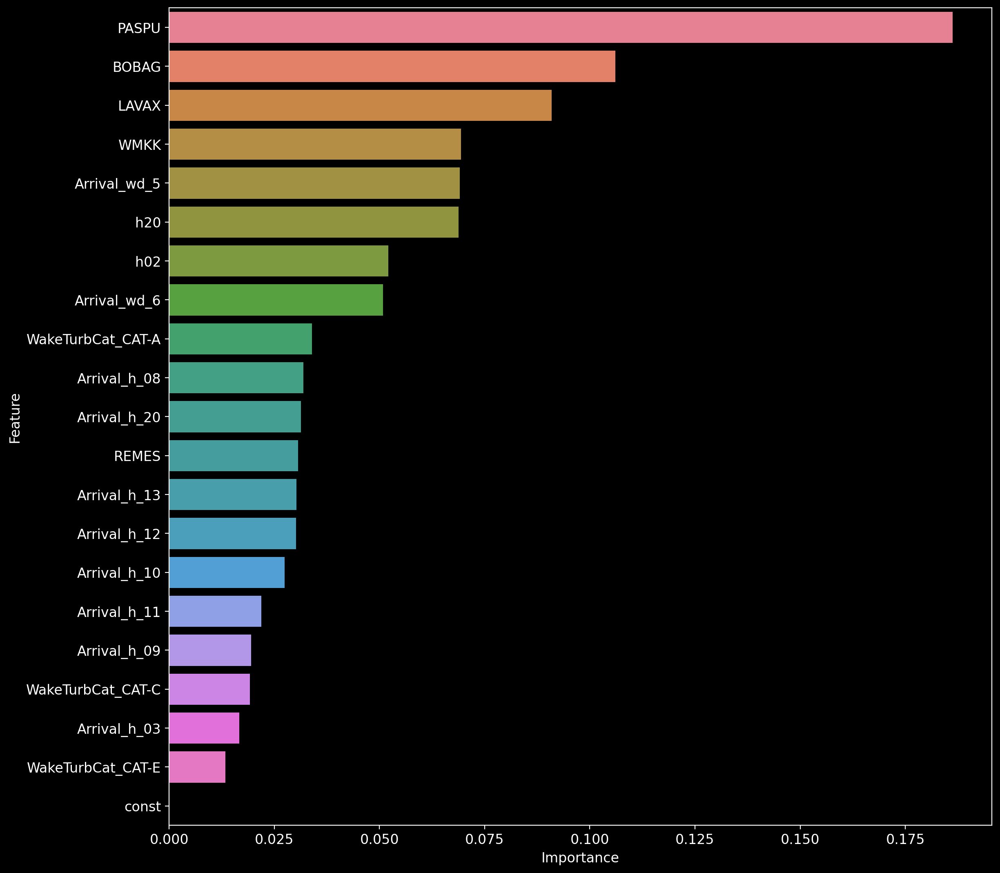

In [115]:
# Importance of features in the random forest

feature_names = list(train_features_scaled_new_2.columns)
importances = rf_estimator_subset.feature_importances_
indices = np.argsort(importances)

names = [feature_names[i] for i in indices]
importancedf = pd.DataFrame(
    {"Feature": names, "Importance": importances[indices]}
).sort_values(by="Importance", ascending=False)

plt.figure(figsize=(13, 13))
sns.barplot(y="Feature", x="Importance", data=importancedf, palette="husl")
plt.show()

# K-Nearest neighbours classifier

              precision    recall  f1-score   support

       False       0.81      0.92      0.86      8754
        True       0.68      0.45      0.54      3319

    accuracy                           0.79     12073
   macro avg       0.75      0.68      0.70     12073
weighted avg       0.78      0.79      0.77     12073



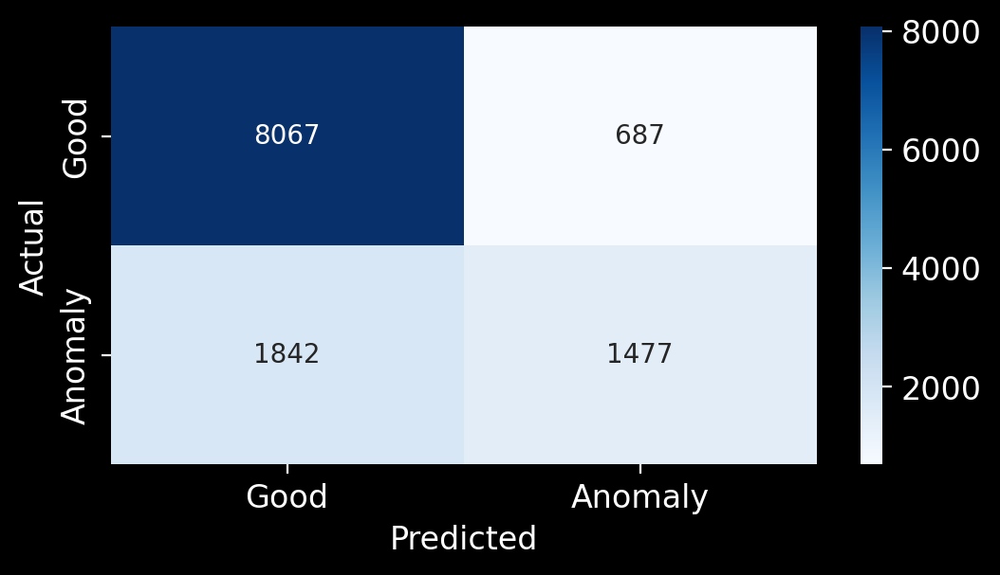

In [116]:
from sklearn.neighbors import KNeighborsClassifier

knn_model = KNeighborsClassifier()
knn_model.fit(train_features, train_target_cat)
knn_train_predictions = knn_model.predict(train_features)
metrics_score(train_target_cat, knn_train_predictions)

# K-Nearest neigbours with scaling and PCA

              precision    recall  f1-score   support

       False       0.82      0.91      0.87      8754
        True       0.68      0.48      0.56      3319

    accuracy                           0.79     12073
   macro avg       0.75      0.70      0.71     12073
weighted avg       0.78      0.79      0.78     12073



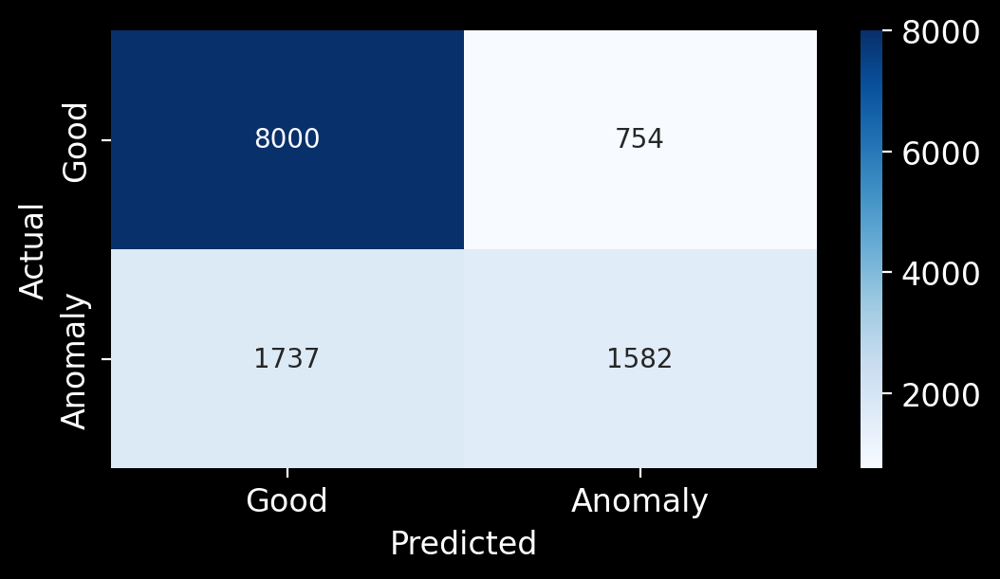

In [117]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

scaler = StandardScaler()
X_train_std = scaler.fit_transform(train_features)
X_test_std = scaler.transform(test_features)
pca = PCA()
X_train_pca = pca.fit_transform(X_train_std)
X_test_pca = pca.transform(X_test_std)

knn_model = KNeighborsClassifier()
knn_model.fit(X_train_pca, train_target_cat)
knn_train_predictions = knn_model.predict(X_train_pca)
metrics_score(train_target_cat, knn_train_predictions)

              precision    recall  f1-score   support

       False       0.75      0.86      0.80      2147
        True       0.47      0.30      0.37       872

    accuracy                           0.70      3019
   macro avg       0.61      0.58      0.58      3019
weighted avg       0.67      0.70      0.68      3019



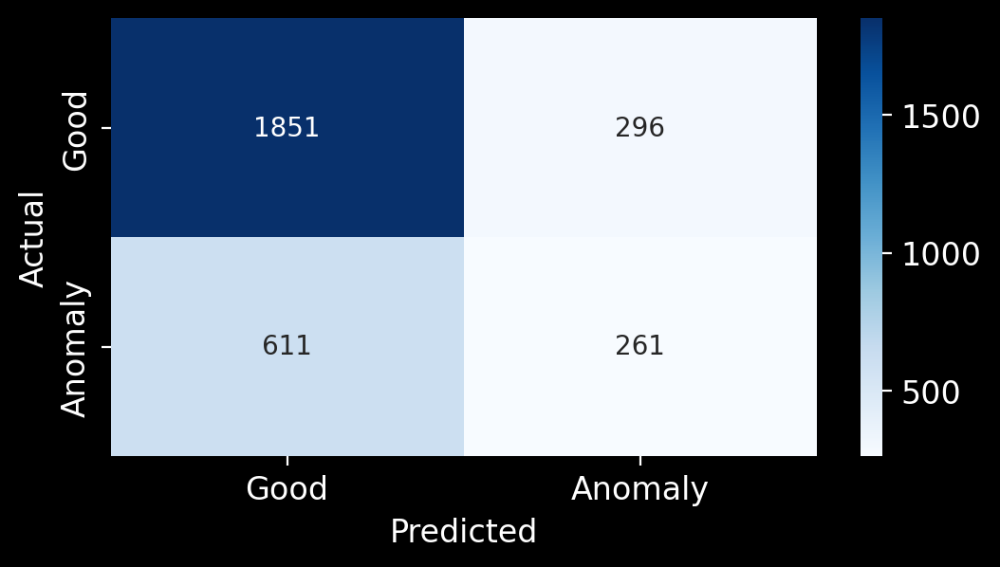

In [118]:
y_test_pred_knn = knn_model.predict(X_test_pca)
metrics_score(test_target_cat, y_test_pred_knn)

### Cross-validation

In [119]:
from sklearn.model_selection import cross_val_score

scores = cross_val_score(knn_model, train_features, train_target_cat, cv=5)
print(
    f"The average score of the model with K-5 Cross validation is {np.average(scores)} "
)

The average score of the model with K-5 Cross validation is 0.7004883178010947 
